# Analytic fits to distributions

In [1]:
import cogsworth
import astropy.units as u
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
import gala.dynamics as gd
import os

from scipy.integrate import quad
from scipy.interpolate import interp1d
import h5py as h5
import functools

In [2]:
import sys
sys.path.append("../src")
import plotting

In [3]:
%config InlineBackend.figure_format = 'retina'

pd.options.display.max_columns = 999

plt.rc('font', family='serif')
plt.rcParams['text.usetex'] = False
fs = 24

# update various fontsizes to match
params = {'figure.figsize': (12, 8),
          'legend.fontsize': fs,
          'axes.labelsize': fs,
          'xtick.labelsize': 0.9 * fs,
          'ytick.labelsize': 0.9 * fs,
          'axes.linewidth': 1.1,
          'xtick.major.size': 7,
          'xtick.minor.size': 4,
          'ytick.major.size': 7,
          'ytick.minor.size': 4}
plt.rcParams.update(params)

In [4]:
from importlib import reload
reload(plotting)

<module 'plotting' from '/mnt/home/twagg/supernova-feedback/notebooks/../src/plotting.py'>

# Read data

In [5]:
pop_details = {
    "file_names": ["fiducial", "Z-0.5", "Z-0.2", "Z-0.1", "Z-0.05"],
    "labels": np.array(["Fiducial",
                        r"$Z = 0.5 \, Z_{\rm m11h}$",
                        r"$Z = 0.2 \, Z_{\rm m11h}$",
                        r"$Z = 0.1 \, Z_{\rm m11h}$",
                        r"$Z = 0.05 \, Z_{\rm m11h}$"]),
}

In [6]:
%%time
pops = {file_name: cogsworth.pop.load(f"/mnt/home/twagg/ceph/pops/feedback-variations/{file_name}.h5", parts=[])
        if os.path.isfile(f"/mnt/home/twagg/ceph/pops/feedback-variations/{file_name}.h5") else None
        for file_name in pop_details["file_names"]}

CPU times: user 3.63 s, sys: 64.7 ms, total: 3.69 s
Wall time: 4.79 s


In [7]:
%%time
for p in pops:
    plotting.set_sn_subpop_masks(pops[p]);
    pops[p]._bpp = pd.read_hdf(f"/mnt/home/twagg/ceph/pops/feedback-variations/{p}.h5", key="bpp")

16426 283504 182812 378076
14970 308041 196284 387789
10745 337789 212648 391381
4340 354694 225390 407448
10001 379956 234221 399962
CPU times: user 59.8 s, sys: 33.2 s, total: 1min 33s
Wall time: 3min 32s


In [8]:
for p in pops:
    sn_rows = pops[p].bpp[((pops[p].bpp["evol_type"] == 15) | (pops[p].bpp["evol_type"] == 16)) & ~pops[p].bpp["bin_num"].isin(pops[p].duplicate_sn)]
    pops[p].had_sn = np.isin(pops[p].bin_nums, sn_rows["bin_num"].unique())

In [9]:
for p in pops:
    f = np.load(f"/mnt/home/twagg/ceph/pops/feedback-variations/sn_positions-{p}.npz")
    pops[p].primary_sn_distances, pops[p].secondary_sn_distances = f["arr_0"] * u.kpc, f["arr_1"] * u.kpc

In [10]:
cs = [plt.get_cmap("Reds_r", len(pops) + 2)(i + 1) for i in range(len(pops))]

# Rate normalisation

## FIRE Rates

In [11]:
@np.vectorize
def FIRE3_rate(t):
    a = [0.39, 0.51, 0.18]
    ts = [3.7, 7.0, 44]
    psi1 = np.log(a[1]/a[0]) / np.log(ts[1]/ts[0])
    psi2 = np.log(a[2]/a[1]) / np.log(ts[2]/ts[1])

    if t < ts[0] or t > ts[2]:
        return 0.0
    elif t < ts[1]:
        return a[0] * (t / ts[0])**psi1
    elif t < ts[2]:
        return a[1] * (t / ts[1])**psi2

In [12]:
fire_per_msun = quad(FIRE3_rate, 0, 44)[0] / 1000

In [13]:
f"FIRE-3 produces {fire_per_msun * 100:1.1f} supernovae per 100 Msun"

'FIRE-3 produces 1.2 supernovae per 100 Msun'

## My rates

In [14]:
@functools.lru_cache()
def __get_imf_normalisation_values(m1=0.01, m2=0.08, m3=0.5, m4=150.0, a12=0.3, a23=1.3, a34=2.3):
    b1 = 1 / (
            (m2 ** (1 - a12) - m1 ** (1 - a12)) / (1 - a12)
            + m2 ** (-(a12 - a23)) * (m3 ** (1 - a23) - m2 ** (1 - a23)) / (1 - a23)
            + m2 ** (-(a12 - a23)) * m3 ** (-(a23 - a34)) * (m4 ** (1 - a34) - m3 ** (1 - a34)) / (1 - a34)
    )
    b2 = b1 * m2 ** (-(a12 - a23))
    b3 = b2 * m3 ** (-(a23 - a34))
    return b1, b2, b3

@np.vectorize
def IMF(m, m1=0.01, m2=0.08, m3=0.5, m4=150.0, a12=0.3, a23=1.3, a34=2.3):
    """Calculate the fraction of stellar mass between m and m + dm for a three part broken power law.

    Default values follow Kroupa (2001)
    https://arxiv.org/abs/astro-ph/0009005
    Equation 1-2

            zeta(m) ~ m^(-a_ij)
    Parameters
    ----------
    m : `float` or `np.ndarray`
        Mass at which to evaluate
    mi : float, optional
        masses at which to transition the slope
    aij : float, optional
        slope of the IMF between mi and mj
    Returns
    -------
    imf_vals
        IMF evaluated at the given masses
    """
    # calculate normalisation constants that ensure the IMF is continuous
    b1, b2, b3 = __get_imf_normalisation_values(m1, m2, m3, m4, a12, a23, a34)

    # evaluate IMF either at a point or for a list of points
    if m1 <= m < m2:
        return b1 * m ** (-a12)
    elif m2 <= m < m3:
        return b2 * m ** (-a23)
    elif m3 <= m < m4:
        return b3 * m ** (-a34)
    else:
        return 0.0

In [15]:
quad(IMF, 15, 150)[0] / quad(IMF, 4, 150)[0]

0.17192959465900653

In [16]:
quad(IMF, 4, 7)[0] / quad(IMF, 4, 150)[0]

0.5215739294757368

In [17]:
quad(IMF, 4, 7, args=(0.01, 0.08, 0.5, 150, 0.3, 1.3, 1.7))[0]/ quad(IMF, 4, 150, args=(0.01, 0.08, 0.5, 150, 0.3, 1.3, 1.7))[0]

0.35195378049534765

In [18]:
quad(IMF, 4, 150, args=(0.01, 0.08, 0.5, 150, 0.3, 1.3, 1.7))[0] / quad(IMF, 4, 150)[0]

5.346620939743228

In [19]:
quad(IMF, 8, 150, args=(0.01, 0.08, 1, 150, 0.3, 1.3, 1.7))[0] / quad(IMF, 8, 150)[0]

9.667863638628322

In [20]:
quad(IMF, 4, 8, args=(0.01, 0.08, 1, 150, 0.3, 1.3, 1.7))[0] / quad(IMF, 4, 8)[0]

4.632800752194503

In [21]:
bins = np.linspace(0, 200, 150)
centres, widths = plotting.get_centres_widths(bins)
times, weights = plotting.get_data_and_weights(pops["fiducial"],
                                               var="time",
                                               widths=widths)
all_times, all_weights = np.concatenate(times), np.concatenate(weights)

In [22]:
total_sn = len(all_times)
total_mass = pops["fiducial"].mass_binaries * u.Msun

In [23]:
my_per_msun = total_sn / total_mass

In [24]:
f"My simulations produce {my_per_msun.value * 100:1.1f} supernovae per 100 Msun"

'My simulations produce 1.2 supernovae per 100 Msun'

## That matches nicely!

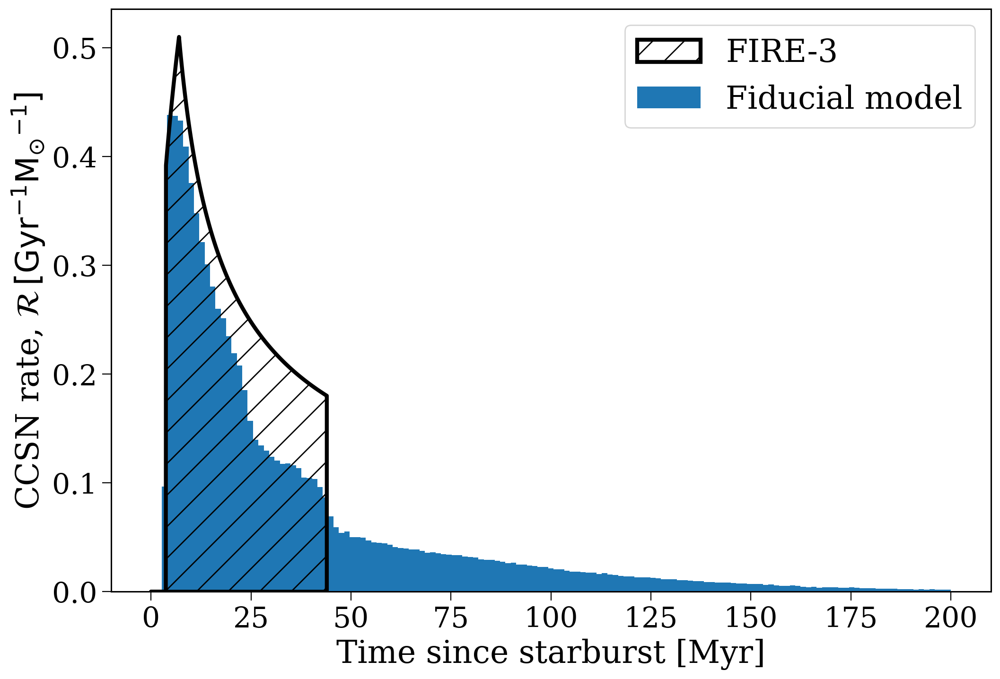

In [25]:
fig, ax = plt.subplots()
t_range = np.linspace(0, 44, 1000)
ax.fill_between(t_range, 0, FIRE3_rate(t_range), lw=3, fc='none',
                hatch="/", label="FIRE-3", ec="black")
ax.hist(all_times, bins=bins,
        weights=all_weights * 1e9 / total_mass, # convert 1/yr to 1/Gyr/Msun
        zorder=-1, label="Fiducial model")

h = np.histogram(all_times, bins=bins, weights=all_weights * 1e9 / total_mass.value), # convert 1/yr to 1/Gyr/Msun

ax.legend()
ax.set_xlabel("Time since starburst [Myr]")
ax.set_ylabel(r"CCSN rate, $\mathcal{R} \, [{\rm Gyr}^{-1} {\rm M_{\odot}}^{-1}]$")

plt.show()

# Supernova time distribution

In [4]:
np.log10(0.017 / 0.0142)

0.07816057699521743

In [47]:
t_range = np.linspace(0, 200, 1000)

def get_rate_parameters(FeH=0, a1=0.38, a2=0.47, a3=0.22, a4=0.13, a5=0.1, a6=0.175,
                        t1=3.5, t2=6, t3=23, t4=28, t5=45.5, t6=200):
    a1 += 0.13 * FeH
    a2 += 0.05 * FeH
    a3 += 0.02 * FeH
    a6 += 0.05 * FeH
    t3 -= 6.5 * FeH
    t4 -= 6.5 * FeH
    t5 -= 16.5 * FeH

    a = [a1, a2, a3, a4, a5, a6]
    ts = [t1, t2, t3, t4, t5, t6]
    psi = [np.log(a[i + 1] / a[i]) / np.log(ts[i + 1] / ts[i]) for i in range(len(a) - 1)]

    return a, ts, psi

@np.vectorize
def my_rate(t, FeH=None, **kwargs):
    if FeH is None:
        FeH = np.log10(0.017 / 0.0142)
    a, ts, psi = get_rate_parameters(FeH=FeH, **kwargs)
    if t < ts[0] or t > ts[-1]:
        return 0.0
    elif t < ts[1]:
        return a[0] * (t / ts[0])**psi[0]
    elif t < ts[2]:
        return a[1] * (t / ts[1])**psi[1]
    elif t < ts[3]:
        return a[2] * (t / ts[2])**psi[2]
    elif t < ts[4]:
        return a[3] * (t / ts[3])**psi[3]
    elif t < ts[5]:
        return a[5] * np.exp(-t / ts[4])
        # return (0.065 + 0.0175 * FeH) / np.exp(-1) * np.exp(-t / ts[4])
        # return a[5] * (t / ts[5])**psi_tail

print("Late SN rate", quad(my_rate, 44, 200)[0] / quad(my_rate, 0, 200)[0])
print(f"Normalisation percentage: {abs(quad(my_rate, 0, 200)[0] / (sum(h[0][0]) * bins[1]) - 1) * 100:1.3f}%")

for Z_factor in [1, 0.5, 0.2, 0.1, 0.05]:
    FeH = np.log10(Z_factor * 0.017 / 0.0142)
    print(round(quad(my_rate, 0, 200, args=(FeH))[0] / quad(my_rate, 0, 200)[0], 2), round(quad(my_rate, 44, 200, args=(FeH))[0] / quad(my_rate, 0, 200, args=(FeH))[0], 2))

/tmp/ipykernel_3434741/1595503588.py:39: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  print("Late SN rate", quad(my_rate, 44, 200)[0] / quad(my_rate, 0, 200)[0])
/tmp/ipykernel_3434741/1595503588.py:40: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 


Late SN rate 0.2427062085037871
Normalisation percentage: 0.341%
1.0 0.24
1.06 0.27
1.12 0.3
1.16 0.32
1.19 0.34


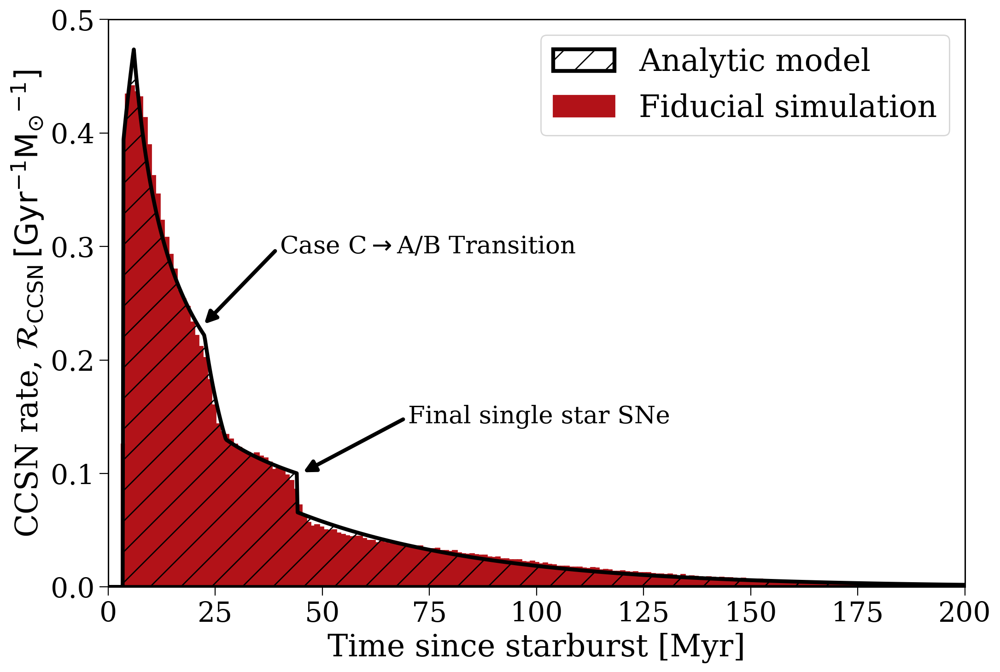

In [48]:
fig, ax = plt.subplots()
t_range = np.linspace(0, 199.99, 1000)
ax.fill_between(t_range, 0, my_rate(t_range, FeH=np.log10(0.017 * 1 / 0.0142)), lw=3, fc='none',
                hatch="/", label="Analytic model", ec="black")

bins = np.linspace(0, 200, 200)
centres, widths = plotting.get_centres_widths(bins)
times, weights = plotting.get_data_and_weights(pops["fiducial"],
                                               var="time",
                                               widths=widths)
all_times, all_weights = np.concatenate(times), np.concatenate(weights)
patches = ax.hist(all_times, bins=bins,
        weights=all_weights * 1e9 / total_mass, # convert 1/yr to 1/Gyr/Msun
        zorder=-1, label="Fiducial simulation", cumulative=False, color=cs[0])[2]
for patch in patches:
    patch.set_edgecolor(patch.get_facecolor())

h = np.histogram(all_times, bins=bins, weights=all_weights * 1e9 / total_mass.value), # convert 1/yr to 1/Gyr/Msun
# ax.plot(centres, h[0][0], lw=3)

ax.legend()
ax.set(xlabel="Time since starburst [Myr]",
       ylabel=r"CCSN rate, $\mathcal{R}_{\rm CCSN} \, [{\rm Gyr}^{-1} {\rm M_{\odot}}^{-1}]$",
       xlim=(0, 200), ylim=(0, 0.5))

for text, textloc, loc in zip([r"Case C$\rightarrow$A/B Transition", "Final single star SNe"], [(40, 0.3), (70, 0.15)], [(22, 0.23), (45, 0.1)]):
    ax.annotate(text, xy=loc, xytext=textloc, fontsize=0.8*fs, arrowprops=dict(arrowstyle="-|>", color="k", relpos=(0.0, 0.5), lw=3), ha="left", va="center")

plt.savefig("../plots/fit_time_fiducial.pdf", format="pdf", bbox_inches="tight")

plt.show()

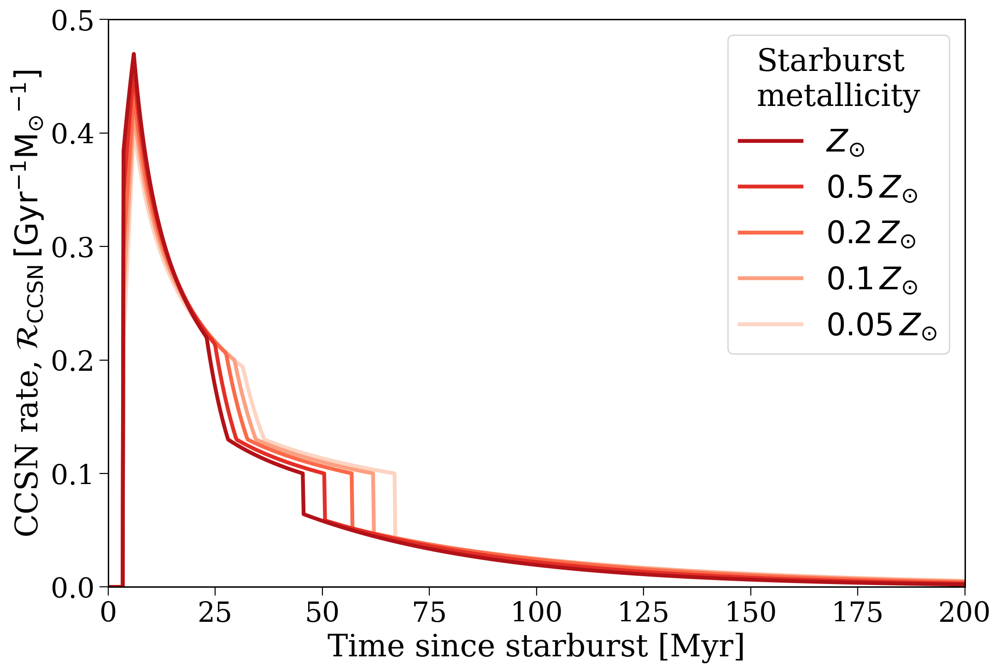

In [49]:
fig, ax = plt.subplots()

for c, Z_rel_sol in zip(cs, [1, 0.5, 0.2, 0.1, 0.05]):
    ax.plot(t_range, my_rate(t_range, FeH=np.log10(Z_rel_sol)), color=c, lw=3, label=fr"${Z_rel_sol} \, Z_{{ \odot}}$" if Z_rel_sol != 1 else r"$Z_{{\odot}}$", zorder=Z_rel_sol)
ax.legend(title="Starburst\nmetallicity", title_fontsize=fs)
ax.set(xlabel="Time since starburst [Myr]",
       ylabel=r"CCSN rate, $\mathcal{R}_{\rm CCSN} \, [{\rm Gyr}^{-1} {\rm M_{\odot}}^{-1}]$",
       xlim=(0, 200), ylim=(0, 0.5))
# ax.plot(t_range, FIRE3_rate(t_range), lw=3, label="FIRE-3", color="grey")

plt.savefig("../plots/fit_time_metallicity.pdf", format="pdf", bbox_inches="tight")

plt.show()

### Sampling function

In [56]:
def cdf_piece(t, i, a, ts, psi):
    return a[i] * ts[i]**-psi[i] * (t**(psi[i] + 1) - ts[i]**(psi[i] + 1)) / (psi[i] + 1)

def cumulative_rate(t, FeH=0):
    a, ts, psi = get_rate_parameters(FeH=FeH)

    cumul_below_t = np.array([0.0 for t in ts])

    for i in range(1, len(ts) - 1):
        cumul_below_t[i:] += cdf_piece(ts[i], i - 1, a, ts, psi)

    @np.vectorize
    def get_cdf(t):
        cdf = None
        if t < ts[0]:
            cdf = 0.0
        elif t < ts[1]: # 6
            cdf = cdf_piece(t, 0, a, ts, psi) + cumul_below_t[0]
        elif t < ts[2]: # 22
            cdf = cdf_piece(t, 1, a, ts, psi) + cumul_below_t[1]
        elif t < ts[3]: # 27
            cdf = cdf_piece(t, 2, a, ts, psi) + cumul_below_t[2]
        elif t < ts[4]: # 44
            cdf = cdf_piece(t, 3, a, ts, psi) + cumul_below_t[3]
        elif t <= ts[5]: # 200
            cdf = ts[4] * a[5] * (np.exp(-1) - np.exp(-t / ts[4])) + cumul_below_t[4]
            # cdf = a[5] / (psi_tail + 1) * (t**(psi_tail + 1) / ts[5]**psi_tail - ts[4]**(psi_tail + 1) / ts[5]**psi_tail)  + cumul_below_t[4]
    
        return cdf

    return get_cdf(t)

In [54]:
def inverse_cdf_rate(u, FeH=0, norm=None, transitions=None):
    a, ts, psi = get_rate_parameters(FeH)
    
    norm = 1 / cumulative_rate(200, FeH=FeH)
    transitions = [cumulative_rate(t, FeH=FeH) * norm for t in ts]
    
    @np.vectorize
    def get_val(u):    
        if u < transitions[1]: # 
            return (ts[0]**psi[0] * ((u / norm - transitions[0] / norm) * (psi[0] + 1) / a[0] + ts[0]))**(1 / (psi[0] + 1))
        elif u < transitions[2]:
            return (ts[1]**psi[1] * ((u / norm - transitions[1] / norm) * (psi[1] + 1) / a[1] + ts[1]))**(1 / (psi[1] + 1))
        elif u < transitions[3]:
            return (ts[2]**psi[2] * ((u / norm - transitions[2] / norm) * (psi[2] + 1) / a[2] + ts[2]))**(1 / (psi[2] + 1))
        elif u < transitions[4]:
            return (ts[3]**psi[3] * ((u / norm - transitions[3] / norm) * (psi[3] + 1) / a[3] + ts[3]))**(1 / (psi[3] + 1))
        else:
            return -ts[4] * np.log(1 / np.e - (u / norm - transitions[4] / norm) / (a[5] * ts[4]))
            # return (ts[5]**psi_tail * ((u / norm - transitions[4] / norm) * (psi_tail + 1) / a[5] + ts[4]**(psi_tail + 1) / ts[5]**psi_tail))**(1 / (psi_tail + 1))

    return get_val(u)

In [52]:
def sample_ccsn_times(n, FeH=0):
    return inverse_cdf_rate(np.random.rand(n), FeH=FeH)

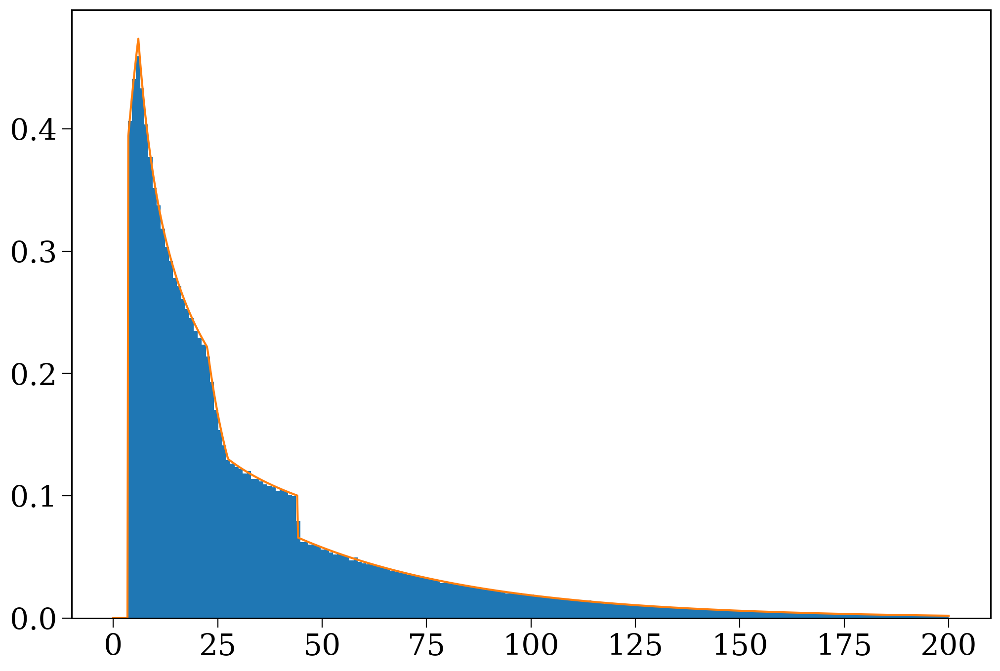

In [57]:
plt.hist(sample_ccsn_times(1000000, FeH=np.log10(0.017 /0.0142)), bins=200, weights=np.repeat(11.79 / 1000000 * 200 / 200, 1000000));
plt.plot(t_range, my_rate(t_range))

## Why are mergers double peaked?
Forward vs. reverse

In [687]:
last_mt_rows = pops["fiducial"].bpp[pops["fiducial"].bpp["evol_type"] == 3].drop_duplicates(subset="bin_num", keep="last")
forward_mt = last_mt_rows[last_mt_rows["RRLO_1"] >= 1]["bin_num"]
reverse_mt = last_mt_rows[(last_mt_rows["RRLO_2"] >= 1) & (last_mt_rows["RRLO_1"] < 1)]["bin_num"]
merger_nums = np.concatenate((pops["fiducial"].sn_1_merger[pops["fiducial"].sn_1_merger].index,
                              pops["fiducial"].sn_2_merger[pops["fiducial"].sn_2_merger].index))
forward_mergers = np.intersect1d(merger_nums, forward_mt)
reverse_mergers = np.intersect1d(merger_nums, reverse_mt)

In [688]:
forward_merger_times = pops["fiducial"].bpp.loc[forward_mergers][pops["fiducial"].bpp.loc[forward_mergers]["evol_type"].isin([15, 16])]["tphys"]
reverse_merger_times = pops["fiducial"].bpp.loc[reverse_mergers][pops["fiducial"].bpp.loc[reverse_mergers]["evol_type"].isin([15, 16])]["tphys"]

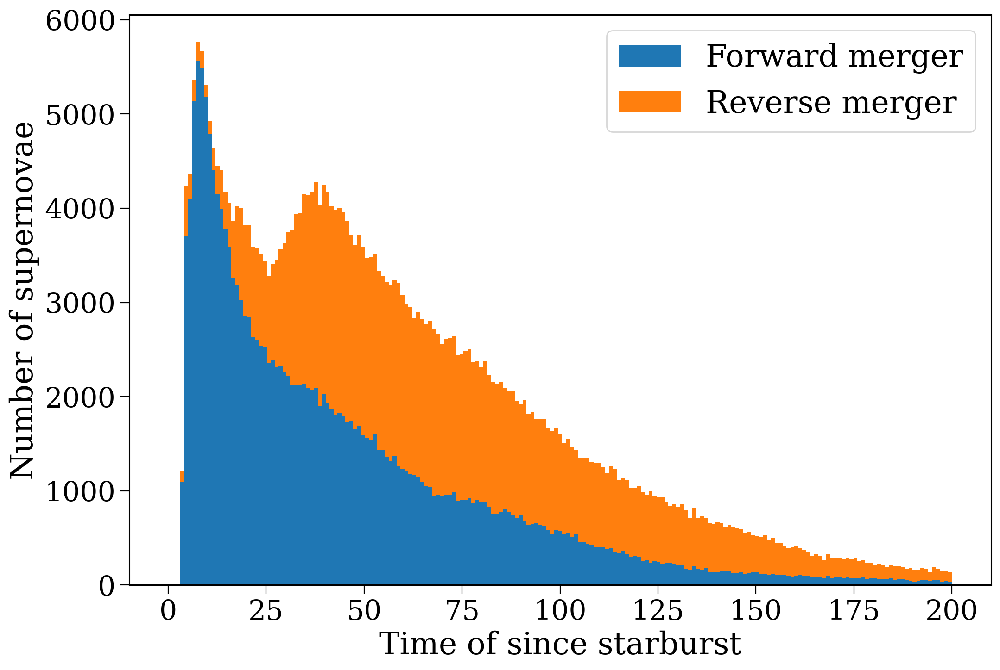

In [689]:
plt.hist([forward_merger_times, reverse_merger_times], stacked=True, bins=bins, label=["Forward merger", "Reverse merger"]);
plt.xlabel("Time of since starburst")
plt.ylabel("Number of supernovae")
plt.legend()
plt.show()

In [58]:
from scipy.stats import expon, norm, maxwell, powerlaw, beta, pareto, laplace_asymmetric, lognorm, loguniform, loggamma

In [59]:
from scipy.optimize import curve_fit, Bounds

# Supernova spatial distribution

## Ejection velocities

### Actual distribution

182265 0.00044440786766521275


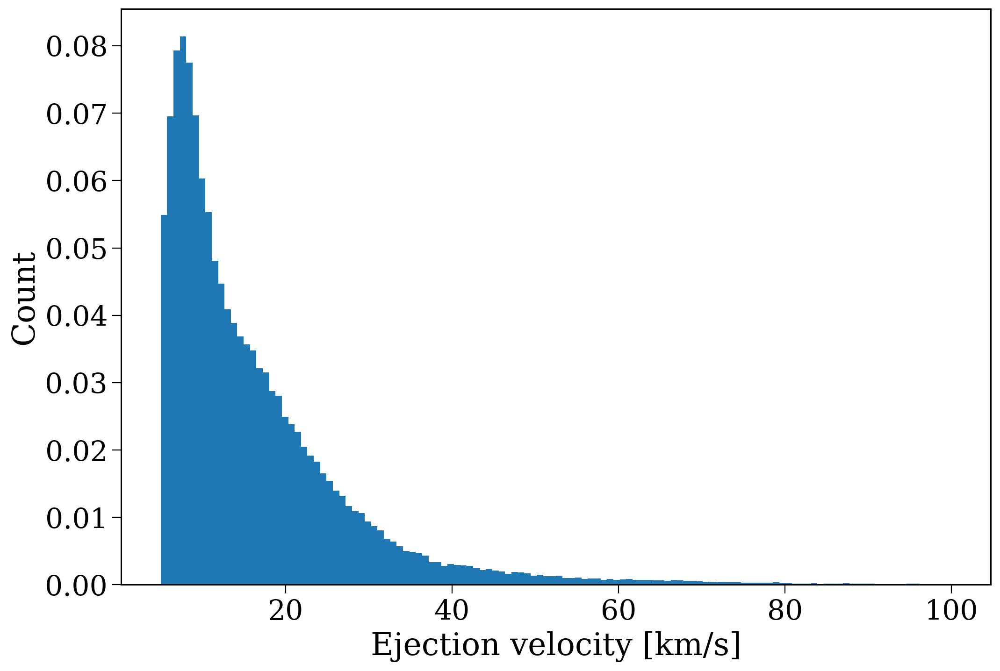

In [252]:
bins = np.linspace(5, 100, 125)

fig, ax = plt.subplots()

sn_2_nums = pops["fiducial"].sn_2[pops["fiducial"].sn_2].index

first_sn_rows = pops["fiducial"].kick_info.loc[sn_2_nums].drop_duplicates(subset="bin_num", keep="first")
first_sn_rows = first_sn_rows[first_sn_rows["star"] == 1]

bound_vels = first_sn_rows[first_sn_rows["disrupted"] == 0]["vsys_1_total"]
disrupted_vels = first_sn_rows[first_sn_rows["disrupted"] == 1]["vsys_2_total"]

ejection_vels = np.zeros(len(first_sn_rows))
ejection_vels[first_sn_rows["disrupted"] == 0] = bound_vels.values
ejection_vels[first_sn_rows["disrupted"] == 1] = disrupted_vels.values
print(len(ejection_vels), (ejection_vels == 0.0).sum() / len(ejection_vels))

ax.hist(disrupted_vels, bins=bins, range=(0, 100), cumulative=False, lw=2, density=True)

ax.set(xlabel="Ejection velocity [km/s]", ylabel="Count")

plt.show()

### Mass transfer split
Split the distribution by mass transfer

In [386]:
def plot_ejection_vels(p, bins):
    
    fig, ax = plt.subplots()
    
    sn_2_nums = pops[p].sn_2[pops[p].sn_2].index
    
    first_sn_rows = pops[p].kick_info.loc[sn_2_nums].drop_duplicates(subset="bin_num", keep="first")
    first_sn_rows = first_sn_rows[first_sn_rows["star"] == 1]
    
    disrupted_rows = first_sn_rows[(first_sn_rows["disrupted"] == 1) & (first_sn_rows["vsys_2_total"] > 5)]
    disrupted_vels = disrupted_rows["vsys_2_total"]
    
    nums = disrupted_rows["bin_num"]
    mt_rows = pops[p].bpp[pops[p].bpp["evol_type"] == 3].drop_duplicates(subset="bin_num", keep="first")
    mt_nums = mt_rows["bin_num"].unique()

    case_A_mt_nums = mt_rows[mt_rows["kstar_1"] <= 1]["bin_num"].values
    case_BC_mt_nums = mt_rows[mt_rows["kstar_1"] > 1]["bin_num"].values
    ce_nums = pops[p].bpp[pops[p].bpp["evol_type"] == 7]["bin_num"].unique()

    had_ce = np.isin(nums, ce_nums)
    had_mt = np.isin(nums, mt_nums)
    had_Amt = np.isin(nums, case_A_mt_nums) & ~had_ce
    had_BCmt = np.isin(nums, case_BC_mt_nums) & ~had_ce

    density = True
    
    # ax.hist(disrupted_vels[had_ce], bins=bins, range=(0, 100), cumulative=False, lw=2, density=False, stacked=False, alpha=0.5, label="CE before SN")
    ax.hist(disrupted_vels[~had_mt], bins=bins, range=(5, 100), cumulative=False, lw=2, density=density, stacked=False, alpha=0.5, label="No MT before SN")
    ax.hist(disrupted_vels[had_Amt], bins=bins, range=(5, 100), cumulative=False, lw=2, density=density, stacked=False, alpha=0.5, label="AMT before SN")
    ax.hist(disrupted_vels[had_BCmt], bins=bins, range=(5, 100), cumulative=False, lw=2, density=density, stacked=False, alpha=0.5, label="BCMT before SN")
    ax.hist(disrupted_vels[had_ce], bins=bins, range=(5, 100), cumulative=False, lw=2, density=density, stacked=False, alpha=0.5, label="CE before SN")
    
    ax.set(xlabel="Ejection velocity [km/s]", ylabel="Count", ylim=(0, 0.22 if density else 14000))
    ax.set_title(p, fontsize=fs)

    v_range = np.linspace(5, 100, 1000)
    rel = 1 if p == "fiducial" else float(p.split("-")[1])
    FeH = np.log10(0.017 * rel / 0.0142)

    factor = -1.8 + np.sqrt(abs(FeH)) * 0.5
    # factor = -1.8 - 0.5 * FeH
    f1 = factor + 1
    ax.plot(v_range, ((100**f1 - 5**f1) / f1)**(-1) * v_range**factor, label="No MT fit")
    # ax.plot(v_range, beta(1.2, 20, loc=5,scale=100 - 5).pdf(v_range), label="No MT fit")
    ax.plot(v_range, norm(loc=22 - 8 * FeH, scale=6 - 3 * FeH).pdf(v_range), label="Case A fit")
    ax.plot(v_range, beta(1.5 - 1.5 * FeH, 18 + 5 * FeH, loc=5, scale=95).pdf(v_range), label="Case B fit")
    ax.plot(v_range, beta(5 - FeH * 4, 10, loc=5,scale=100 - 5).pdf(v_range), label=f"CE Fit: beta({0 - FeH * 4:1.2f}, {10:1.2f})")
    ax.legend()

    fracs = np.array([(~had_mt).sum(), had_Amt.sum(), had_BCmt.sum(), had_ce.sum()]) / len(nums)
    
    print(p)
    print(f"  Number of ejections {len(disrupted_vels)}")
    print(f'  Fraction of pop ejected {len(disrupted_vels) / len(pops[p].bpp[pops[p].bpp["evol_type"].isin([15, 16])]):1.3f}')
    print(f'  Fraction no MT {fracs[0]:1.2f}')
    print(f"  Fraction case A MT {fracs[1]:1.2f}")
    print(f"  Fraction case BC MT {fracs[2]:1.2f}")
    print(f"  Fraction CE {fracs[3]:1.2f}")
    # print(f"  Fraction had CE {had_ce.sum() / len(nums):1.2f}")
    
    plt.show()

    return disrupted_vels, fracs

fiducial
  Number of ejections 154969
  Fraction of pop ejected 0.178
  Fraction no MT 0.12
  Fraction case A MT 0.12
  Fraction case BC MT 0.70
  Fraction CE 0.06


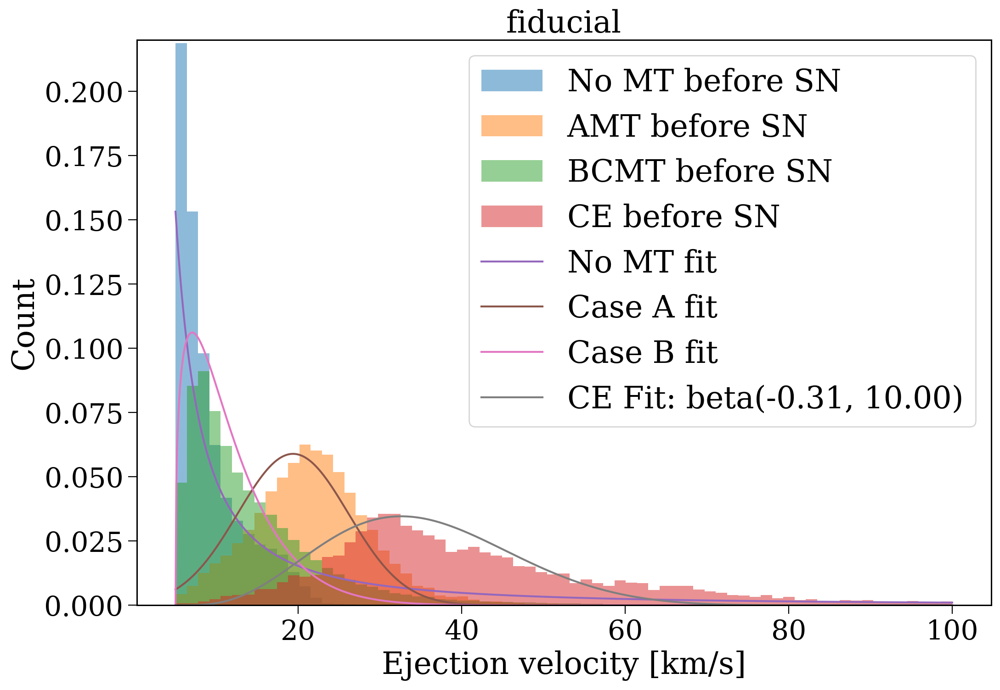

Z-0.5
  Number of ejections 163516
  Fraction of pop ejected 0.178
  Fraction no MT 0.23
  Fraction case A MT 0.11
  Fraction case BC MT 0.60
  Fraction CE 0.06


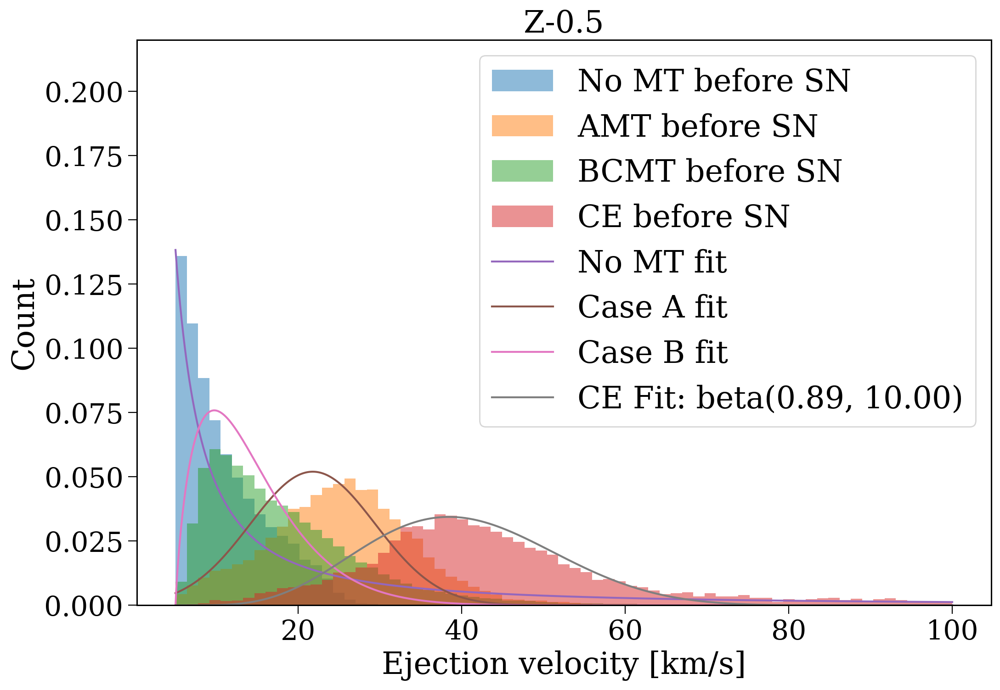

Z-0.2
  Number of ejections 171234
  Fraction of pop ejected 0.178
  Fraction no MT 0.23
  Fraction case A MT 0.10
  Fraction case BC MT 0.60
  Fraction CE 0.08


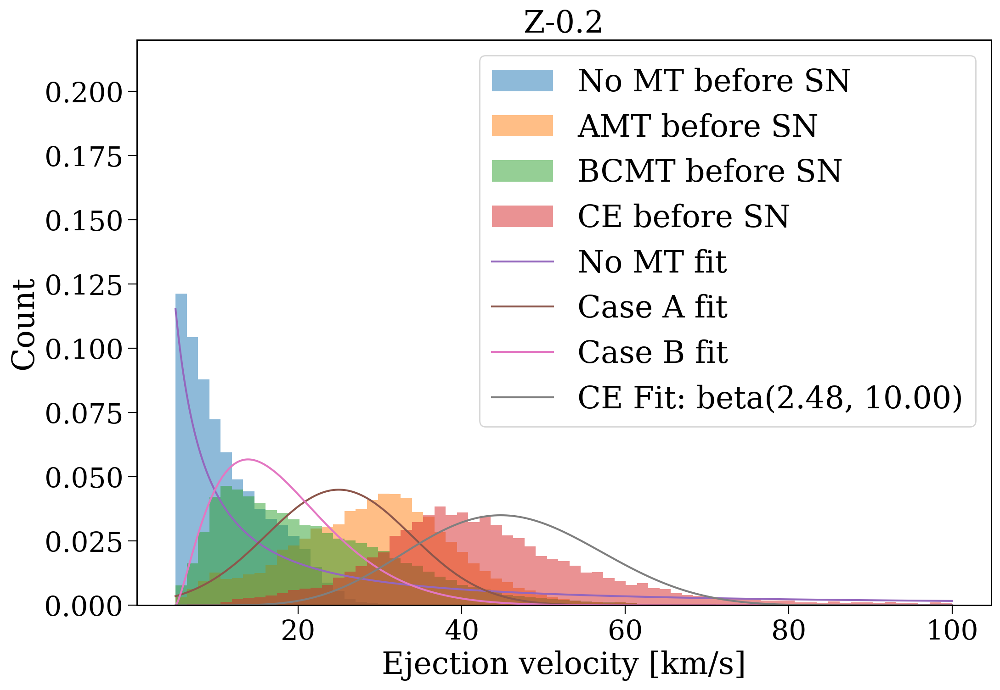

Z-0.05
  Number of ejections 181226
  Fraction of pop ejected 0.175
  Fraction no MT 0.28
  Fraction case A MT 0.08
  Fraction case BC MT 0.53
  Fraction CE 0.10


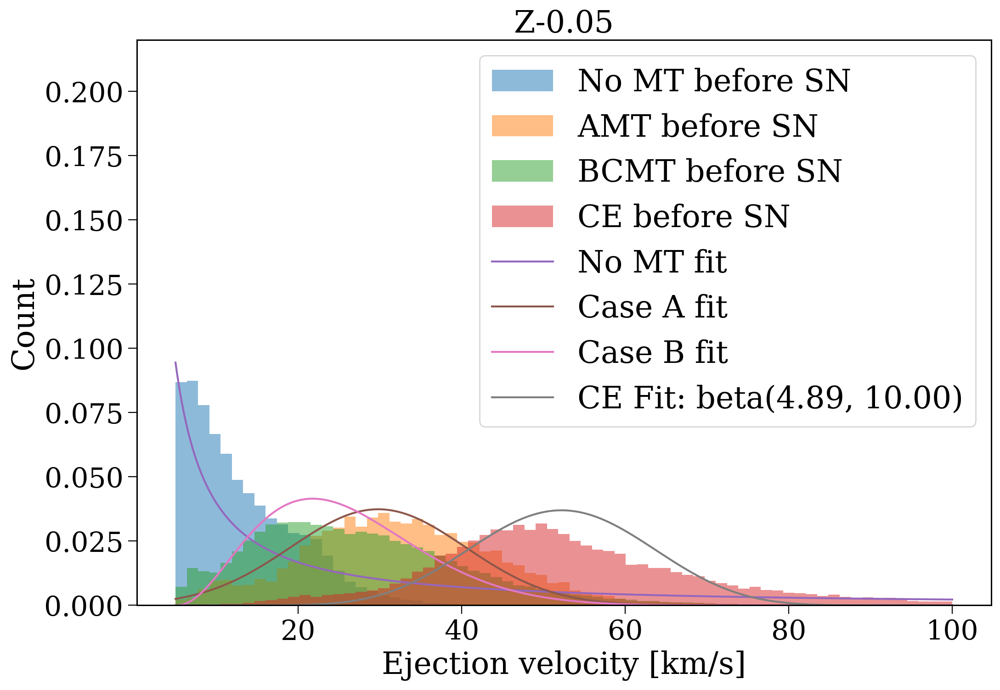

In [381]:
bins = np.linspace(5, 100, 70)
# Z_fracs = np.zeros((len(pops), 4))
for i, Z in enumerate(pops):
    if Z == "Z-0.1":
        continue
    vels, fracs = plot_ejection_vels(Z, bins);
    Z_fracs[i] = fracs
    # break

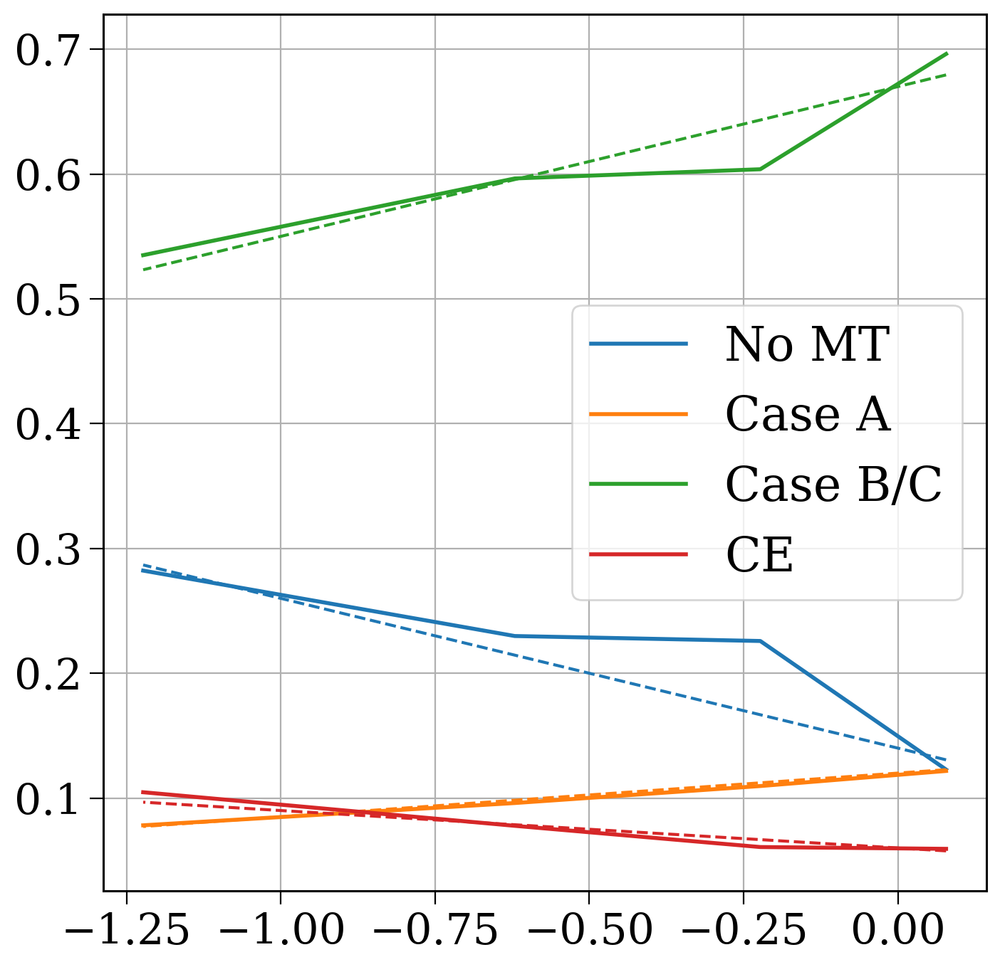

In [125]:
fig, ax = plt.subplots(figsize=(8, 8))

inds = [0, 1, 2, 4]
FeHs = np.array([np.log10(0.017 * x / 0.0142) for x in [1, 0.5, 0.2, 0.1, 0.05]])

for i, label, coeffs in zip([0, 1, 2, 3], ["No MT", "Case A", "Case B/C", "CE"], [(0.14, -0.12), (0.12, 0.035), (0.67, 0.12), (0.06, -0.03)]):
    plt.plot(FeHs[inds], Z_fracs[inds, i], label=label, color=f"C{i}", lw=2)
    plt.plot(FeHs[inds], coeffs[0] + FeHs[inds] * coeffs[1], color=f"C{i}", linestyle="--")

# plt.yticks(np.arange(0, 0.8, 0.05))

plt.grid()

plt.legend()

### Compare fiducial fit

In [362]:
def plot_fitted_runaways(p, i, c=None, label=None, show=True):
    bins = np.linspace(5, 100, 100)
    centres, _ = plotting.get_centres_widths(bins)

    Z_rel_m11h = 1 if p == "fiducial" else float(p.split("-")[1])
    FeH = np.log10(0.017 * Z_rel_m11h / 0.0142)
    
    fig, ax = plt.subplots()

    sn_2_nums = pops[p].sn_2[pops[p].sn_2].index
    
    first_sn_rows = pops[p].kick_info.loc[sn_2_nums].drop_duplicates(subset="bin_num", keep="first")
    first_sn_rows = first_sn_rows[first_sn_rows["star"] == 1]
    
    disrupted_vels = first_sn_rows[first_sn_rows["disrupted"] == 1]["vsys_2_total"]
    
    fast_ones = disrupted_vels[disrupted_vels > 5]

    nums = fast_ones.index
    mt_rows = pops[p].bpp[pops[p].bpp["evol_type"] == 3].drop_duplicates(subset="bin_num", keep="first")
    mt_nums = mt_rows["bin_num"].unique()

    case_A_mt_nums = mt_rows[mt_rows["kstar_1"] <= 1]["bin_num"].values
    ce_nums = pops[p].bpp[pops[p].bpp["evol_type"] == 7]["bin_num"].unique()
    had_ce = np.isin(nums, ce_nums)
    had_mt = np.isin(nums, mt_nums)
    had_caseA_mt = np.isin(nums, case_A_mt_nums)

    print(p, FeH)
    # print(f"  No MT fraction: {(~had_mt).sum() / len(nums) * 100:1.1f}%")
    # print(f"  Stable MT fraction: {(had_mt & ~had_ce).sum() / had_mt.sum() * 100:1.1f}%")
    # print(f"  Fraction unstable: {had_ce.sum() / had_mt.sum() * 100:1.1f}%")
    # print(f"  Fraction stable case A: {(had_caseA_mt & ~had_ce).sum() / (had_mt).sum() * 100:1.1f}%")

    # ax.hist(fast_ones[had_ce], bins=bins, cumulative=False, lw=2, density=True, label=f"{p} simulation CE", alpha=0.5)
    # ax.hist(fast_ones[had_mt & ~had_ce], bins=bins, cumulative=False, lw=2, density=True, label=f"{p} simulation mt", alpha=0.5)
    # ax.hist(fast_ones[~had_mt], bins=bins, cumulative=False, lw=2, density=True, label=f"{p} simulation no mt", alpha=0.5)

    for val in [10, 30, 50]:
        print(f"  Diff at {val}: {((fast_ones > val).sum() / len(fast_ones)) - quad(ejection_velocity_model, val, 100, args=(FeH))[0]:1.3f}")

    # fast_ones = fast_ones[had_ce]
    patches = ax.hist(fast_ones, bins=bins, cumulative=False, lw=2, density=True,
                      label=f"{p} simulation" if label is None else label,
                      color=cs[i] if c is None else c)[2]
    for patch in patches:
        patch.set_edgecolor(patch.get_facecolor())
    h, _ = np.histogram(fast_ones, bins=bins)
    
    v_range = np.linspace(5, 100, 1000)
    ax.fill_between(v_range, 0, ejection_velocity_model(v_range, FeH), edgecolor="black", facecolor="none", hatch="/", lw=3, label="Analytic model")
    
    ax.set(xlabel=r"Ejection velocity, $v_{\rm ej} \, [{\rm km/s}]$",
           ylabel=r"${\rm d}N/{\rm d}v_{\rm ej}$",
           xlim=(0, 100))
           #, ylim=(0, 0.085))
    ax.legend()

    ax.axvspan(0, 5, color="grey", alpha=0.3, lw=0)

    if show:
        plt.show()

    return fig, ax

In [6]:
import matplotlib.pyplot as plt

In [384]:
def ejection_velocity_model(v, FeH):
    f_no_MT = 0.14 - 0.12 * FeH
    f_caseA = 0.12 + 0.035 * FeH
    f_caseB = 0.67 + 0.12 * FeH
    f_CE = 0.06 - 0.03 * FeH
    # print(f_no_MT, f_caseA, f_caseB, f_CE)


    factor = -1.8 + np.sqrt(abs(FeH)) * 0.5
    f1 = factor + 1
    no_mt_fit = ((100**f1 - 5**f1) / f1)**(-1) * v**factor
    
    caseA_fit = norm(loc=22 - 8 * FeH, scale=6 - 3 * FeH).pdf(v)
    caseB_fit = beta(1.5 - 1.5 * FeH, 18 + 5 * FeH, loc=5, scale=100 - 5).pdf(v)
    CE_fit = beta(5 - FeH * 4, 10, loc=5,scale=100 - 5).pdf(v)

    return f_no_MT * no_mt_fit + f_caseA * caseA_fit + f_caseB * caseB_fit + f_CE * CE_fit

fiducial 0.07816057699521743
  Diff at 10: 0.035
  Diff at 30: 0.024
  Diff at 50: 0.008


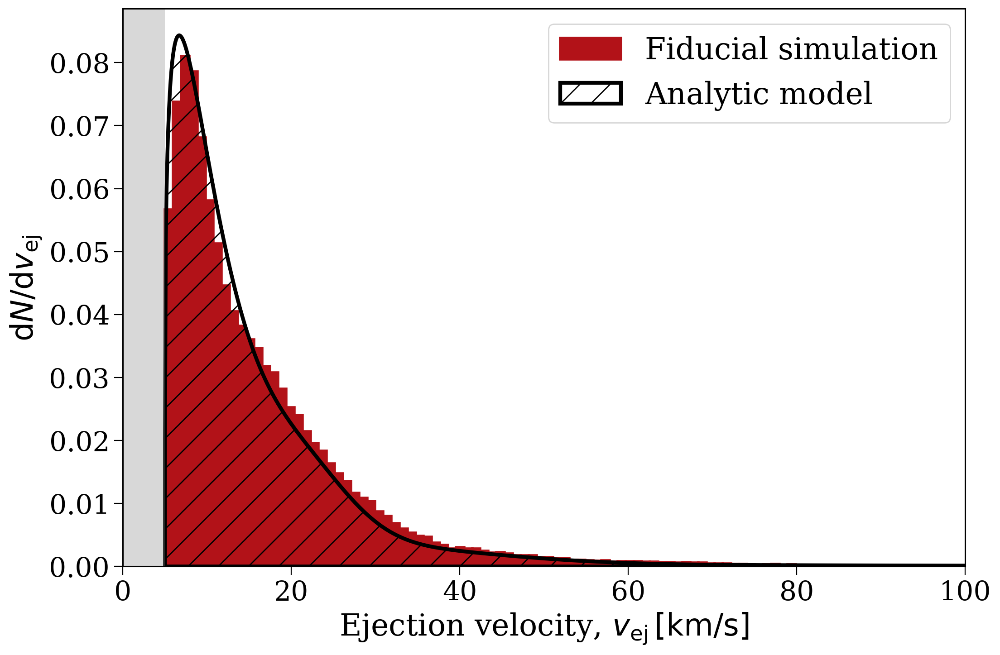

In [387]:
fig, ax = plot_fitted_runaways("fiducial", None, cs[0], "Fiducial simulation", show=False)

plt.savefig("../plots/fit_vel_fiducial.pdf", format="pdf", bbox_inches="tight")
plt.show()

### Metallicity dependence

fiducial 0.07816057699521743
  Diff at 10: 0.035
  Diff at 30: 0.024
  Diff at 50: 0.008


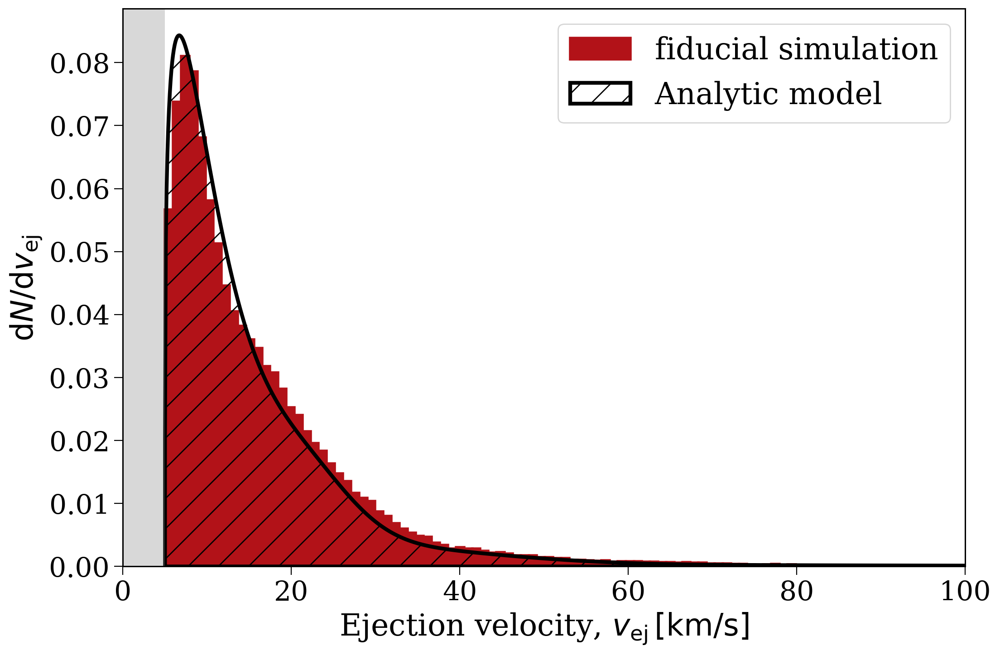

Z-0.5 -0.22286941866876375
  Diff at 10: 0.031
  Diff at 30: 0.026
  Diff at 50: 0.000


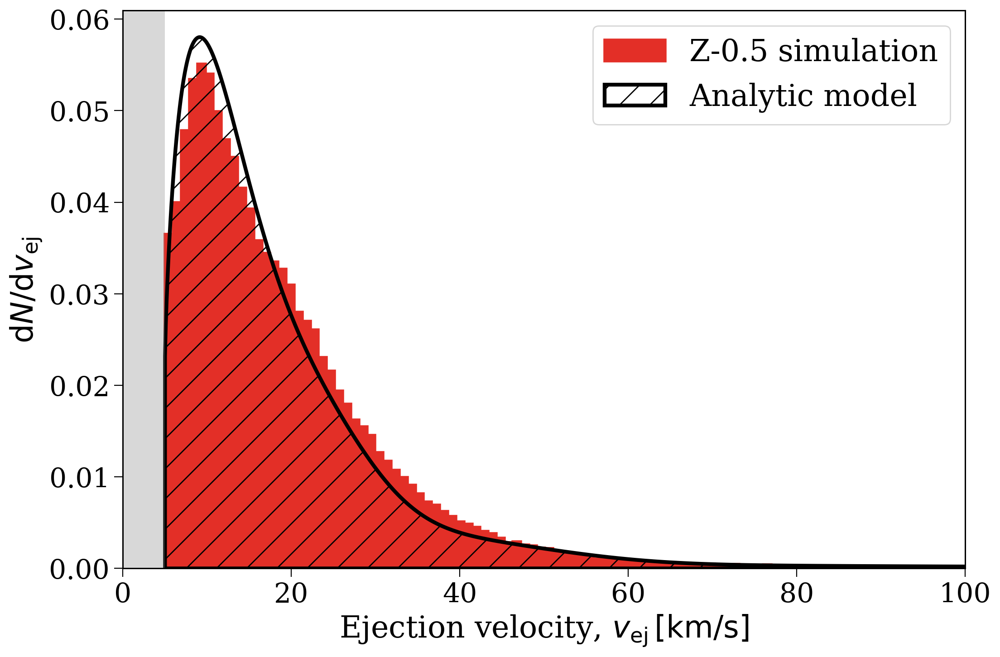

Z-0.2 -0.6208094273408014
  Diff at 10: -0.022
  Diff at 30: 0.031
  Diff at 50: -0.017


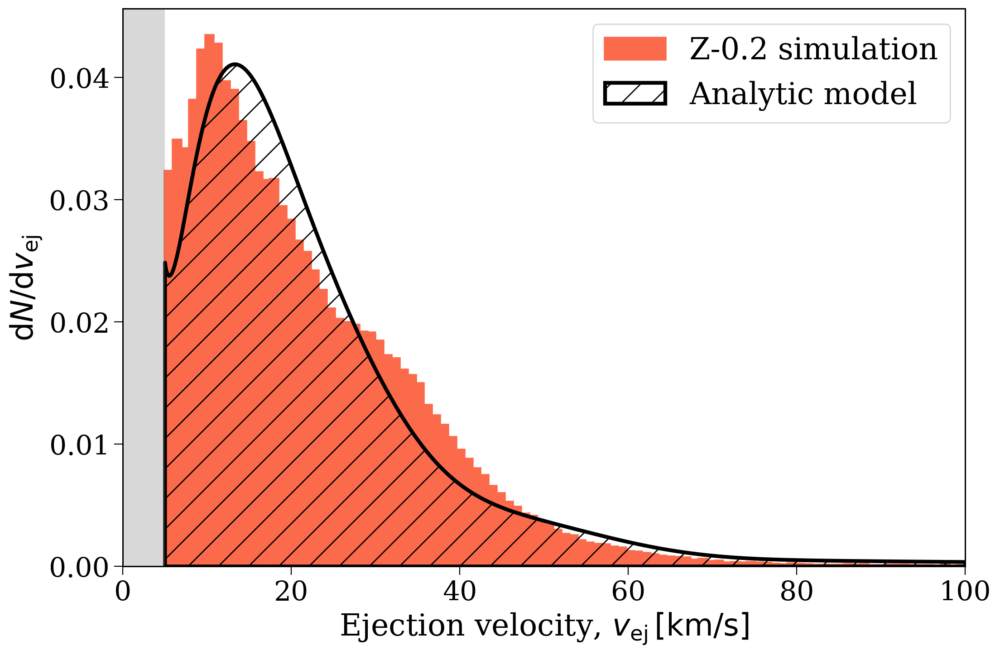

Z-0.05 -1.2228694186687636
  Diff at 10: -0.035
  Diff at 30: -0.037
  Diff at 50: -0.021


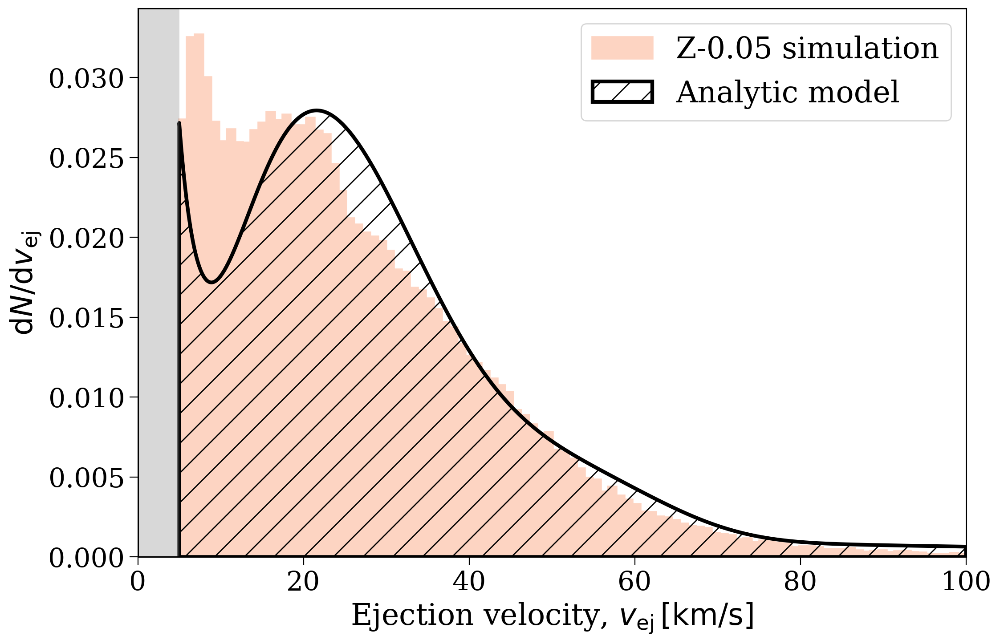

In [365]:
for i, p in enumerate(pops):
    if p == "Z-0.1":
        continue
    plot_fitted_runaways(p, i)

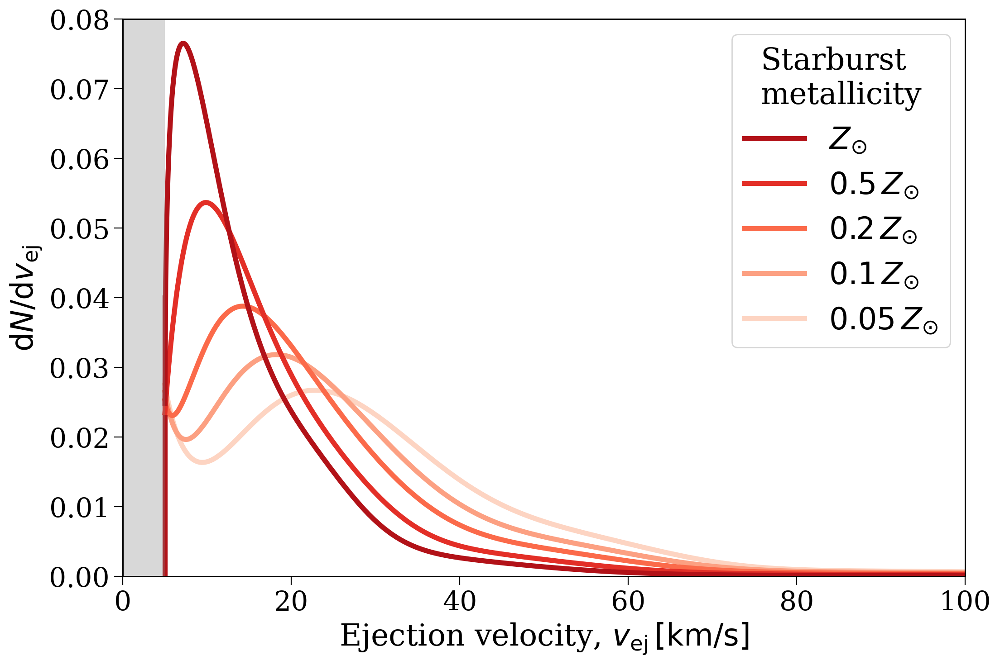

In [390]:
fig, ax = plt.subplots()

for Z_rel_sol, c in zip([1, 0.5, 0.2, 0.1, 0.05], cs):
    FeH = np.log10(Z_rel_sol)
    v_range = np.linspace(4.99, 100, 1000)
    ax.plot(v_range, ejection_velocity_model(v_range, FeH=FeH), color=c, lw=4, label=fr"${Z_rel_sol} \, Z_{{\odot}}$" if Z_rel_sol != 1 else r"$Z_{{\odot}}$", zorder=FeH)
ax.legend(title="Starburst\nmetallicity", title_fontsize=fs)
ax.set(xlabel=r"Ejection velocity, $v_{\rm ej} \, [{\rm km/s}]$",
       ylabel=r"${\rm d}N/{\rm d}v_{\rm ej}$",
       ylim=(0, 0.08), xlim=(0, 100))

ax.axvline(5, 0, 0.5, color=cs[0], zorder=-1, lw=4)
ax.axvspan(0, 5, color="grey", alpha=0.3, lw=0)

plt.savefig("../plots/fit_vel_metallicity.pdf", format="pdf", bbox_inches="tight")

plt.show()

## Fraction of walk/runaway stars

0.18002527828182033
0.036224692338229454
0.2503044996153252
0.04656067221352665


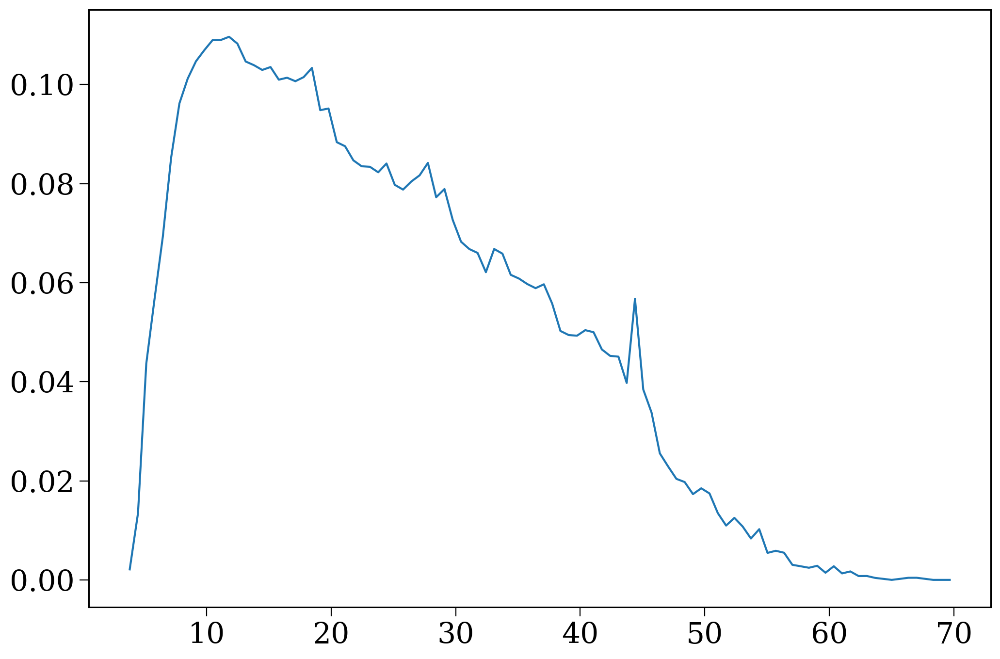

0.1802655542375348
0.001517785688660761
0.25465428704466964
0.10238282594796635


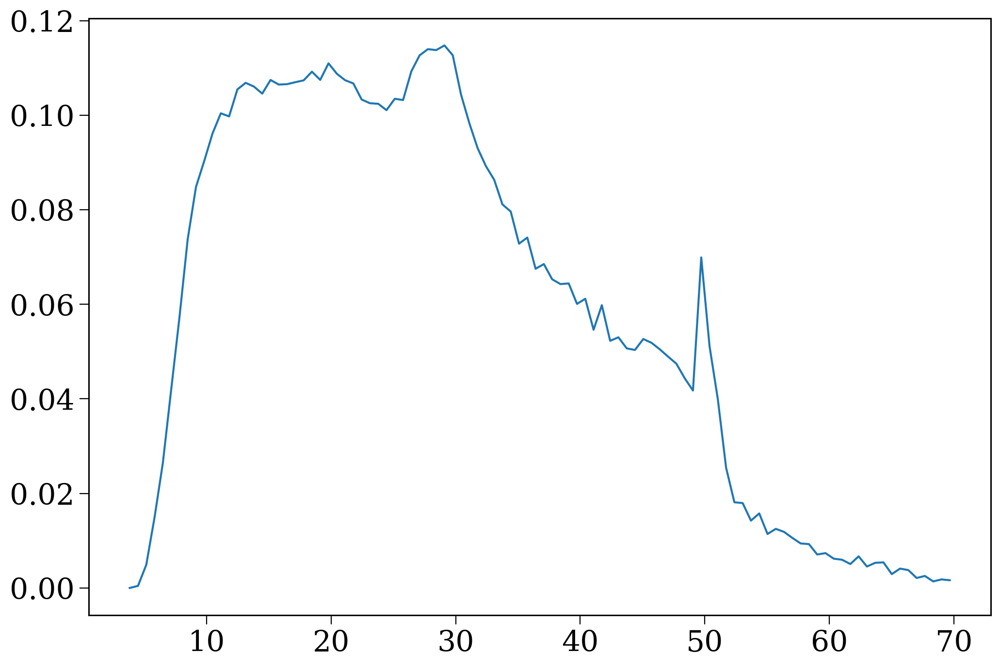

0.17976133862012275
0.0
0.25182501285334535
0.1409081421604903


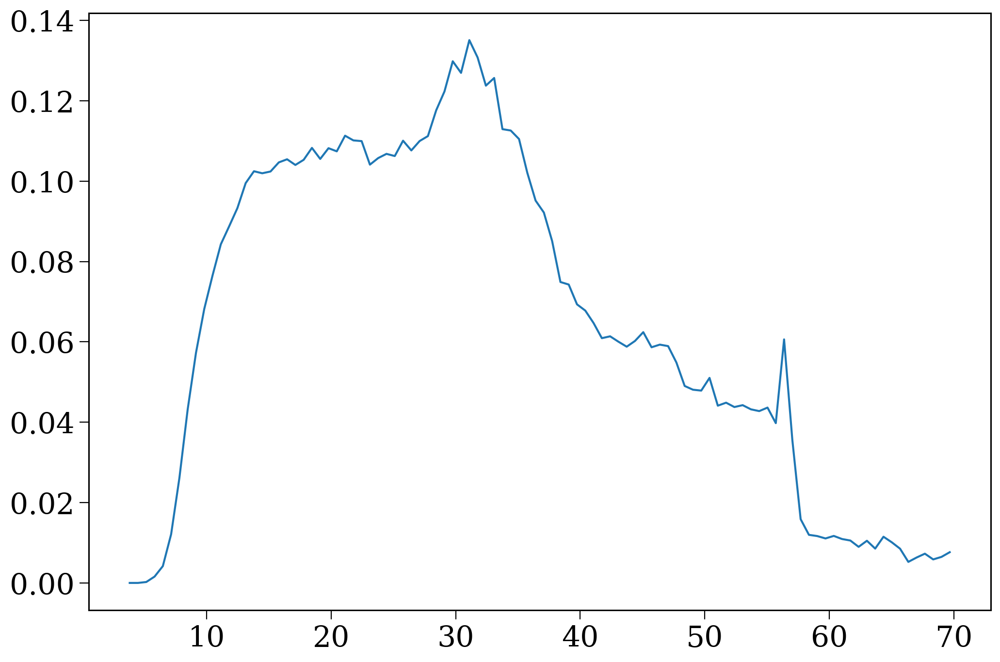

0.17722145599432185
0.0
0.24952802312766534
0.15147013361728437


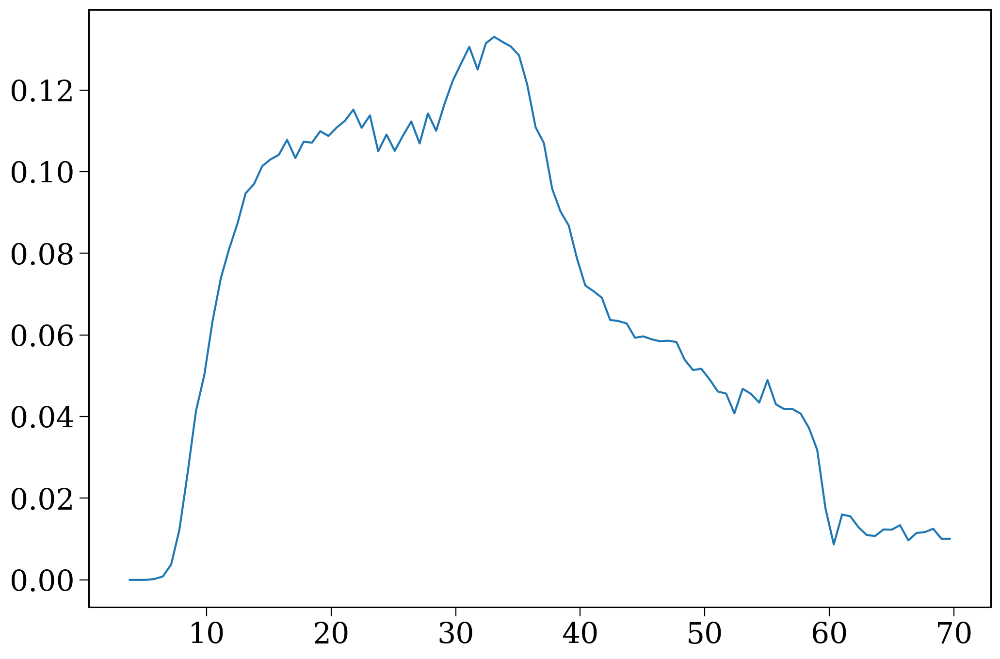

0.17695432265120004
0.0
0.24214227155199597
0.1692694309818704


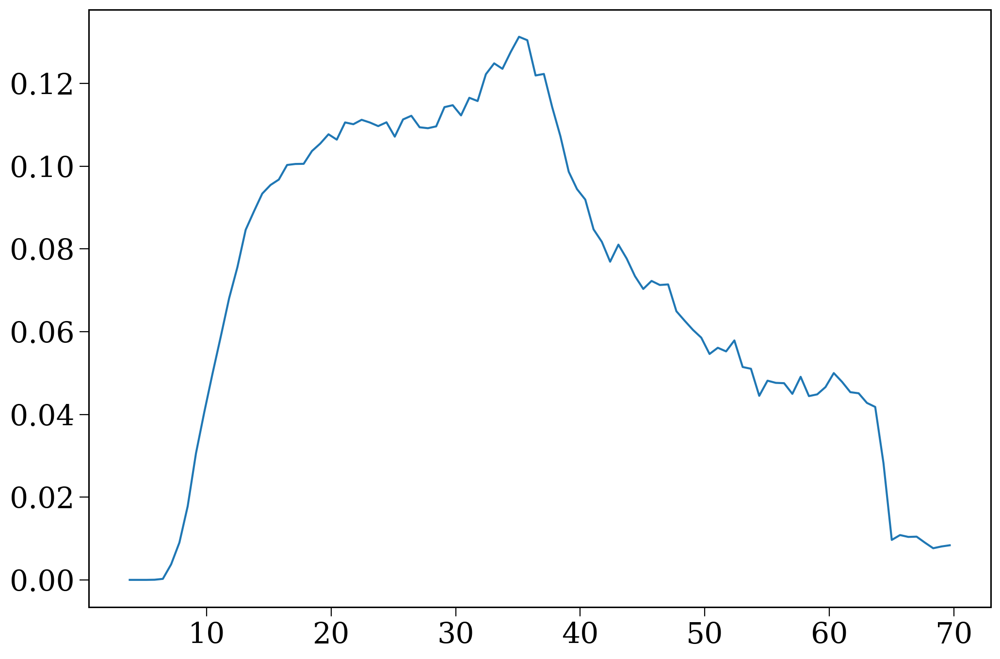

In [485]:
for p in pops:
    # sim = bf1
    sim = pops[p]
    
    sn_2_nums = sim.sn_2[sim.sn_2].index
    
    first_sn_rows = sim.kick_info.loc[sn_2_nums].drop_duplicates(subset="bin_num", keep="first")
    first_sn_rows = first_sn_rows[first_sn_rows["star"] == 1]
    disrupted_vels = first_sn_rows[first_sn_rows["disrupted"] == 1]["vsys_2_total"]
    aways = disrupted_vels[disrupted_vels > 5].index
    
    aways_times = sim.bpp[sim.bpp["evol_type"] == 16].loc[aways]["tphys"]
    h, bins = np.histogram(aways_times, bins=100, range=(3.5, 70), weights=np.repeat(5.1e-07, len(aways)) * 1e9 / total_mass)
    centres = plotting.get_centres_widths(bins)[0]
    
    Z_rel_m11h = 1 if p == "fiducial" else float(p.split("-")[1])
    
    # plt.plot(centres, h)
    plt.plot(centres, h / my_rate(centres, FeH=np.log10(0.017 * Z_rel_m11h / 0.0142)))
    # plt.plot(centres, 0.3 - 0.006 * (centres - 10))
    
    all_times = np.concatenate((plotting.get_data_and_weights(sim, "time", [1])[0]))
    
    print(len(aways_times) / len(all_times))
    print(len(aways_times[aways_times < 5]) / len(all_times[all_times < 5]))
    print(len(aways_times[(aways_times >= 5) & (aways_times < 44)]) / len(all_times[(all_times >= 5) & (all_times < 44)]))
    # print(len(aways_times[aways_times < 44]) / len(all_times[all_times < 44]))
    # print(len(aways_times[(aways_times >= 10) & (aways_times < 44)]) / len(all_times[(all_times >= 10) & (all_times < 44)]))
    print(len(aways_times[(aways_times >= 44) & (aways_times < 60)]) / len(all_times[(all_times >= 44) & (all_times < 60)]))
    plt.show()

# Full sampling routine

In [1265]:
0.06 / 0.82

0.07317073170731707

In [372]:
from scipy.stats import expon, beta, maxwell

def sample_ccsn(n, FeH=0, v_disp=1.7, f_eject = 0.22):
    times = sample_ccsn_times(n=n, FeH=FeH)
    vels = maxwell(scale=v_disp / np.sqrt(3)).rvs(n)

    inds = np.arange(n)
    
    low_t_inds = inds[(times > 5) & (times < 45.5 - 16.5 * FeH)]
    eject_inds = np.random.choice(low_t_inds, int(len(low_t_inds) * 0.24), replace=False)
    
    low_t_inds = inds[(times > 45.5 - 16.5 * FeH) & (times < 60)]
    eject_inds = np.concatenate((eject_inds, np.random.choice(low_t_inds, int(len(low_t_inds) * 0.1), replace=False)))

    n_eject = len(eject_inds)
    f_no_MT = 0.14 - 0.12 * FeH
    n_no_MT = int(f_no_MT * n_eject)
    
    factor = -1.8 + np.sqrt(abs(FeH)) * 0.5
    f1 = factor + 1
    A = ((100**f1 - 5**f1) / f1)**(-1)
    u = np.random.rand(n_no_MT)
    eject_nomt = (u * f1 / A + 5**f1)**(1/f1)
    
    f_caseA = 0.12 + 0.035 * FeH
    n_caseA = int(f_caseA * n_eject)
    eject_caseA_mt = norm(loc=22 - 8 * FeH, scale=6 - 3 * FeH).rvs(n_caseA)

    f_caseB = 0.67 + 0.12 * FeH
    n_caseB = int(f_caseB * n_eject)
    eject_caseB_later_mt = beta(1.5 - 1.5 * FeH, 18 + 5 * FeH, loc=5, scale=100 - 5).rvs(n_caseB)

    n_CE = n_eject - n_no_MT - n_caseA - n_caseB
    eject_CE_mt = beta(5 - FeH * 4, 10, loc=5,scale=100 - 5).rvs(n_CE)

    eject_vels = np.concatenate((eject_caseA_mt, eject_CE_mt, eject_caseB_later_mt, eject_nomt))
    print(len(eject_vels))

    vels[eject_inds] = eject_vels

    return times, vels

def sample_ccsn_simple(n, FeH=0, v_disp=1.7, f_eject = 0.22):
    times = sample_ccsn_times(n=n, FeH=FeH)
    vels = maxwell(scale=v_disp / np.sqrt(3)).rvs(n)

    inds = np.arange(n)
    
    low_t_inds = inds[(times > 5) & (times < 44)]
    eject_inds = np.random.choice(low_t_inds, int(len(low_t_inds) * 0.24), replace=False)
    
    low_t_inds = inds[(times > 44) & (times < 60)]
    eject_inds = np.concatenate((eject_inds, np.random.choice(low_t_inds, int(len(low_t_inds) * 0.1), replace=False)))
    
    n_eject = len(eject_inds)
    f_MT = 0.87 + 0.13 * FeH
    n_MT = int(f_MT * n_eject)
    
    eject_mt = beta(1.4 - 0.9 * FeH, 12 + 2.5 * FeH, loc=5, scale=100).rvs(n_MT)
    
    factor = -1.8 + np.sqrt(abs(FeH)) * 0.5
    f1 = factor + 1
    A = ((100**f1 - 5**f1) / f1)**(-1)
    u = np.random.rand(n_eject - n_MT)
    eject_nomt = (u * f1 / A + 5**f1)**(1/f1)

    eject_vels = np.concatenate((eject_mt, eject_nomt))
    print(len(eject_vels))

    vels[eject_inds] = eject_vels

    return times, vels

In [406]:
times, vels = sample_ccsn(860818, FeH=np.log10(0.017 / 0.0142))
times_simple, vels_simple = sample_ccsn_simple(860818, FeH=np.log10(0.017 / 0.0142))

152118
151808


## Compare 2D distributions

### Get fiducial values

In [392]:
p = "fiducial"

In [393]:
particles = pd.read_hdf("../data/FIRE_star_particles.h5")
x, y, z = particles["x"].values * u.kpc, particles["y"].values * u.kpc, particles["z"].values * u.kpc
v_x = particles["v_x"].values * u.km / u.s
v_y = particles["v_y"].values * u.km / u.s
v_z = particles["v_z"].values * u.km / u.s
v_R = (x * v_x + y * v_y) / (x**2 + y**2)**0.5
v_T = (x * v_y - y * v_x) / (x**2 + y**2)**0.5

In [394]:
v_particle = np.array([v_R, v_T, v_z]).T

In [395]:
v_parent = v_particle[pops[p].initC["particle_id"].values]

In [396]:
v_SN = np.array([pops[p].initial_galaxy.v_R, pops[p].initial_galaxy.v_T, pops[p].initial_galaxy.v_z]).T

In [397]:
pos_SN = np.array([pops[p].initial_galaxy.x, pops[p].initial_galaxy.y, pops[p].initial_galaxy.z]).T
pos_parent = np.array([x, y, z]).T[pops[p].initC["particle_id"].values]

In [398]:
sn_2_nums = pops[p].sn_2[pops[p].sn_2].index.values

In [399]:
sn_2_kicks = pops[p].kick_info.loc[sn_2_nums]
sn_2_kicks = sn_2_kicks[sn_2_kicks["star"] == 1]

In [400]:
# sn_2_after_1 = sn_2_nums[np.isin(sn_2_nums, (pops[p].kick_info.loc[sn_2_nums]["star"] == 1)["bin_num"].values)]
v_ejected = np.zeros(len(sn_2_nums))
v_ejected[np.isin(sn_2_nums, sn_2_kicks.index.values)] = sn_2_kicks["vsys_2_total"]

In [401]:
v_unejected = np.linalg.norm(v_SN - v_parent, axis=1)
v_unejected_1 = v_unejected[np.isin(pops[p].bin_nums, pops[p].sn_1.index.values)]
v_unejected_2 = v_unejected[np.isin(pops[p].bin_nums, pops[p].sn_2.index.values)]

v_list = [np.concatenate((v_unejected_1[pops[p].sn_1_singles], v_unejected_2[pops[p].sn_2_singles])),
     v_unejected_1[pops[p].sn_1],
     np.where(v_ejected > 5, v_ejected, v_unejected_2[pops[p].sn_2]),
        # v_unejected_2[pops[p].sn_2],
     np.concatenate((v_unejected_1[pops[p].sn_1_merger], v_unejected_2[pops[p].sn_2_merger]))]
v = list(reversed(np.concatenate(v_list)))

In [402]:
sn_nums = [np.concatenate((pops[p].sn_1_singles[pops[p].sn_1_singles].index, pops[p].sn_2_singles[pops[p].sn_2_singles].index)),
     pops[p].sn_1[pops[p].sn_1].index,
     pops[p].sn_2[pops[p].sn_2].index,
     np.concatenate((pops[p].sn_1_merger[pops[p].sn_1_merger].index, pops[p].sn_2_merger[pops[p].sn_2_merger].index))]
sn_nums = np.array(list(reversed(np.concatenate(sn_nums))))

In [403]:
def get_mt_1_type(p):
    mt_1_type = pd.Series(np.zeros(len(p)), index=p.bin_nums)

    kstar_mt_1 = p.bpp[(p.bpp["evol_type"] == 3) & (p.bpp["RRLO_1"] >= 1)].drop_duplicates(subset="bin_num", keep="first")["kstar_1"]    
    for low, high, t in [(-np.inf, 1, 1), (1, 4, 2), (4, 6, 3)]:
        mt_1_type.loc[kstar_mt_1[(kstar_mt_1 > low) & (kstar_mt_1 <= high)].index] = t
    return mt_1_type

In [404]:
sn_mt1_type = get_mt_1_type(pops[p]).loc[sn_nums]

### Difference from model

In [332]:
from scipy.interpolate import griddata
import scipy.ndimage as ndimage

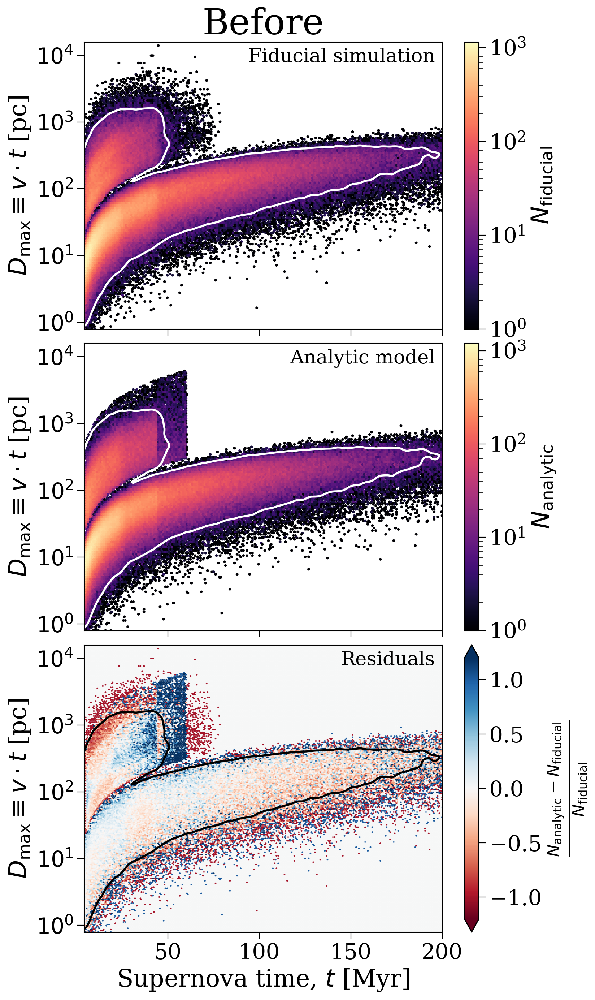

In [350]:
extent = (4, 200, -0.1, 4.2)
gridsize = 200

fig, axes = plt.subplots(3, 1, figsize=(8, 16), sharex=True)

fig.subplots_adjust(hspace=0.05)

dists_simple = (vels_simple * times_simple * u.km / u.s * u.Myr).to(u.pc).value

hb1 = axes[1].hexbin(times_simple, np.log10(dists_simple), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)
fig.colorbar(hb1, label=r"$N_{\rm analytic}$", ax=axes[1])# plt.show()

p = "fiducial"
t_list = plotting.get_data_and_weights(pops[p], "time", [1])[0]
t = np.concatenate(t_list)

hb2 = axes[0].hexbin(t, np.log10(v * t), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)
fig.colorbar(hb2, label=r"$N_{\rm fiducial}$", ax=axes[0])


# Compute difference
counts1 = hb1.get_array()
counts2 = hb2.get_array()
diff_counts = ((counts1 - counts2) / counts2).data # Compute difference

bin_centers = hb1.get_offsets()
x_centers, y_centers = bin_centers[:, 0], bin_centers[:, 1]

# Create a grid of x and y values
xi = np.linspace(x_centers.min(), x_centers.max(), 220)
yi = np.linspace(y_centers.min(), y_centers.max(), 220)
xi, yi = np.meshgrid(xi, yi)

# Interpolate the z values onto the grid
zi = griddata((x_centers, y_centers), counts2, (xi, yi), method='linear')

sorted_counts = np.sort(counts2)[::-1]  # Sort descending
cumsum_counts = np.cumsum(sorted_counts)  # Cumulative sum
cumsum_counts /= cumsum_counts[-1]  # Normalize to fraction of total

# Find the value corresponding to the 98% threshold
contour_level = sorted_counts[np.searchsorted(cumsum_counts, 0.98)]
other_contour_level = sorted_counts[np.searchsorted(cumsum_counts, 0.9)]

# New plot with differences
hb_diff = axes[2].hexbin(x_centers, y_centers, gridsize=gridsize, C=diff_counts, alpha=None, extent=extent,
                         cmap="RdBu", edgecolor="none", vmin=-1.2, vmax=1.2, rasterized=True)
fig.colorbar(hb_diff, label=r"$\frac{N_{\rm analytic} - N_{\rm fiducial}}{N_{\rm fiducial}}$", ax=axes[2], extend="both")

for ax, label in zip(axes, ["Fiducial simulation", "Analytic model", "Residuals"]):
    ax.set(xlim=(extent[0], extent[1]),
           ylim=(extent[2], extent[3]),
           ylabel=r"$D_{\rm max} \equiv v \cdot t$ [pc]")
    ax.set_yticks([0, 1, 2, 3, 4])
    ax.set_yticklabels([r"$10^{0}$", r"$10^{1}$", r"$10^{2}$", r"$10^{3}$", r"$10^{4}$"])
    ax.annotate(label, xy=(0.98, 0.98), xycoords="axes fraction", ha="right", va="top", fontsize=0.8*fs)
    ax.contour(xi, yi, ndimage.gaussian_filter(zi, sigma=2), levels=[contour_level],
               colors="white" if label != "Residuals" else "black", linewidths=2)
    # ax.contour(xi, yi, ndimage.gaussian_filter(zi, sigma=2), levels=[other_contour_level],
    #            colors="white" if label != "Residuals" else "black", linewidths=2)
axes[-1].set(xlabel="Supernova time, $t$ [Myr]")

axes[0].set_title("Before", fontsize=1.5 * fs)

# plt.savefig("../plots/fit-2d.pdf", format="pdf", bbox_inches="tight")

plt.show()

/tmp/ipykernel_3434741/4057050830.py:10: RuntimeWarning: invalid value encountered in log10
  hb1 = axes[1].hexbin(times, np.log10(dists), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)


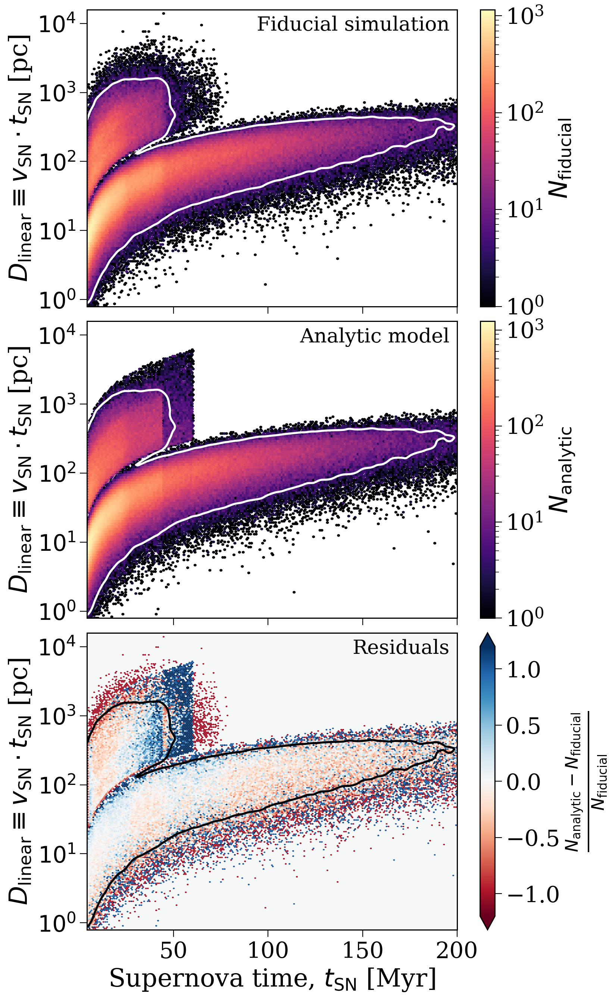

In [410]:
extent = (4, 200, -0.1, 4.2)
gridsize = 200

fig, axes = plt.subplots(3, 1, figsize=(8, 16), sharex=True)

fig.subplots_adjust(hspace=0.05)

dists = (vels * times * u.km / u.s * u.Myr).to(u.pc).value

hb1 = axes[1].hexbin(times, np.log10(dists), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)
fig.colorbar(hb1, label=r"$N_{\rm analytic}$", ax=axes[1])# plt.show()

p = "fiducial"
t_list = plotting.get_data_and_weights(pops[p], "time", [1])[0]
t = np.concatenate(t_list)

hb2 = axes[0].hexbin(t, np.log10(v * t), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)
fig.colorbar(hb2, label=r"$N_{\rm fiducial}$", ax=axes[0])


# Compute difference
counts1 = hb1.get_array()
counts2 = hb2.get_array()
diff_counts = ((counts1 - counts2) / counts2).data # Compute difference

bin_centers = hb1.get_offsets()
x_centers, y_centers = bin_centers[:, 0], bin_centers[:, 1]

# Create a grid of x and y values
xi = np.linspace(x_centers.min(), x_centers.max(), 220)
yi = np.linspace(y_centers.min(), y_centers.max(), 220)
xi, yi = np.meshgrid(xi, yi)

# Interpolate the z values onto the grid
zi = griddata((x_centers, y_centers), counts2, (xi, yi), method='linear')

sorted_counts = np.sort(counts2)[::-1]  # Sort descending
cumsum_counts = np.cumsum(sorted_counts)  # Cumulative sum
cumsum_counts /= cumsum_counts[-1]  # Normalize to fraction of total

# Find the value corresponding to the 98% threshold
contour_level = sorted_counts[np.searchsorted(cumsum_counts, 0.98)]
other_contour_level = sorted_counts[np.searchsorted(cumsum_counts, 0.9)]

# New plot with differences
hb_diff = axes[2].hexbin(x_centers, y_centers, gridsize=gridsize, C=diff_counts, alpha=None, extent=extent,
                         cmap="RdBu", edgecolor="none", vmin=-1.2, vmax=1.2, rasterized=True)
fig.colorbar(hb_diff, label=r"$\frac{N_{\rm analytic} - N_{\rm fiducial}}{N_{\rm fiducial}}$", ax=axes[2], extend="both")

for ax, label in zip(axes, ["Fiducial simulation", "Analytic model", "Residuals"]):
    ax.set(xlim=(extent[0], extent[1]),
           ylim=(extent[2], extent[3]),
           ylabel=r"$D_{\rm linear} \equiv v_{\rm SN} \cdot t_{\rm SN}$ [pc]")
    ax.set_yticks([0, 1, 2, 3, 4])
    ax.set_yticklabels([r"$10^{0}$", r"$10^{1}$", r"$10^{2}$", r"$10^{3}$", r"$10^{4}$"])
    ax.annotate(label, xy=(0.98, 0.98), xycoords="axes fraction", ha="right", va="top", fontsize=0.8*fs)
    ax.contour(xi, yi, ndimage.gaussian_filter(zi, sigma=2), levels=[contour_level],
               colors="white" if label != "Residuals" else "black", linewidths=2)
    # ax.contour(xi, yi, ndimage.gaussian_filter(zi, sigma=2), levels=[other_contour_level],
    #            colors="white" if label != "Residuals" else "black", linewidths=2)
axes[-1].set(xlabel=r"Supernova time, $t_{\rm SN}$ [Myr]")

# axes[0].set_title("After", fontsize=1.5 * fs)

plt.savefig("../plots/fit-2d.pdf", format="pdf", bbox_inches="tight")

plt.show()

In [413]:
(pd.read_hdf("/mnt/home/twagg/ceph/pops/feedback-variations/r442/r442_init_recent_stars.h5")["Z"] * 2).mean()

0.017917730275281953

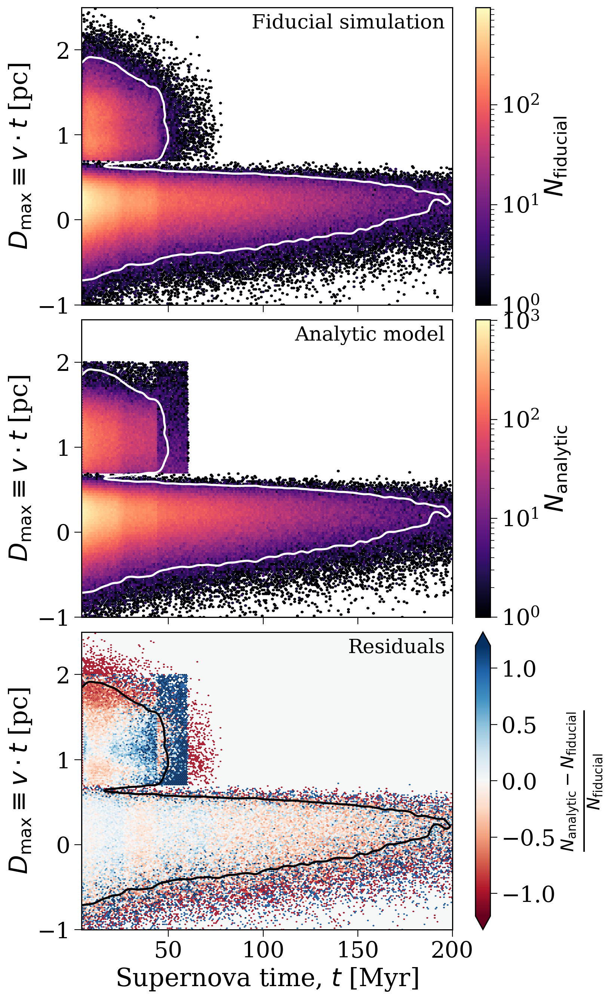

In [352]:
extent = (4, 200, -1, 2.5)
gridsize = 200

fig, axes = plt.subplots(3, 1, figsize=(8, 16), sharex=True)

fig.subplots_adjust(hspace=0.05)

hb1 = axes[1].hexbin(times_simple, np.log10(vels_simple), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)
fig.colorbar(hb1, label=r"$N_{\rm analytic}$", ax=axes[1])# plt.show()

p = "fiducial"
t_list = plotting.get_data_and_weights(pops[p], "time", [1])[0]
t = np.concatenate(t_list)

hb2 = axes[0].hexbin(t, np.log10(v), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)
fig.colorbar(hb2, label=r"$N_{\rm fiducial}$", ax=axes[0])


# Compute difference
counts1 = hb1.get_array()
counts2 = hb2.get_array()
diff_counts = ((counts1 - counts2) / counts2).data # Compute difference

bin_centers = hb1.get_offsets()
x_centers, y_centers = bin_centers[:, 0], bin_centers[:, 1]

# Create a grid of x and y values
xi = np.linspace(x_centers.min(), x_centers.max(), 220)
yi = np.linspace(y_centers.min(), y_centers.max(), 220)
xi, yi = np.meshgrid(xi, yi)

# Interpolate the z values onto the grid
zi = griddata((x_centers, y_centers), counts2, (xi, yi), method='linear')

sorted_counts = np.sort(counts2)[::-1]  # Sort descending
cumsum_counts = np.cumsum(sorted_counts)  # Cumulative sum
cumsum_counts /= cumsum_counts[-1]  # Normalize to fraction of total

# Find the value corresponding to the 98% threshold
contour_level = sorted_counts[np.searchsorted(cumsum_counts, 0.98)]

# New plot with differences
hb_diff = axes[2].hexbin(x_centers, y_centers, gridsize=gridsize, C=diff_counts, alpha=None, extent=extent,
                         cmap="RdBu", edgecolor="none", vmin=-1.2, vmax=1.2, rasterized=True)
fig.colorbar(hb_diff, label=r"$\frac{N_{\rm analytic} - N_{\rm fiducial}}{N_{\rm fiducial}}$", ax=axes[2], extend="both")

for ax, label in zip(axes, ["Fiducial simulation", "Analytic model", "Residuals"]):
    ax.set(xlim=(extent[0], extent[1]),
           ylim=(extent[2], extent[3]),
           ylabel=r"$D_{\rm max} \equiv v \cdot t$ [pc]")
    # ax.set_yticks([0, 1, 2, 3, 4])
    # ax.set_yticklabels([r"$10^{0}$", r"$10^{1}$", r"$10^{2}$", r"$10^{3}$", r"$10^{4}$"])
    ax.annotate(label, xy=(0.98, 0.98), xycoords="axes fraction", ha="right", va="top", fontsize=0.8*fs)
    ax.contour(xi, yi, ndimage.gaussian_filter(zi, sigma=2), levels=[contour_level],
               colors="white" if label != "Residuals" else "black", linewidths=2)
axes[-1].set(xlabel="Supernova time, $t$ [Myr]")

# plt.savefig("../plots/fit-2d.pdf", format="pdf", bbox_inches="tight")

plt.show()

/tmp/ipykernel_3434741/554909996.py:10: RuntimeWarning: invalid value encountered in log10
  hb1 = axes[1].hexbin(times, np.log10(vels), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)


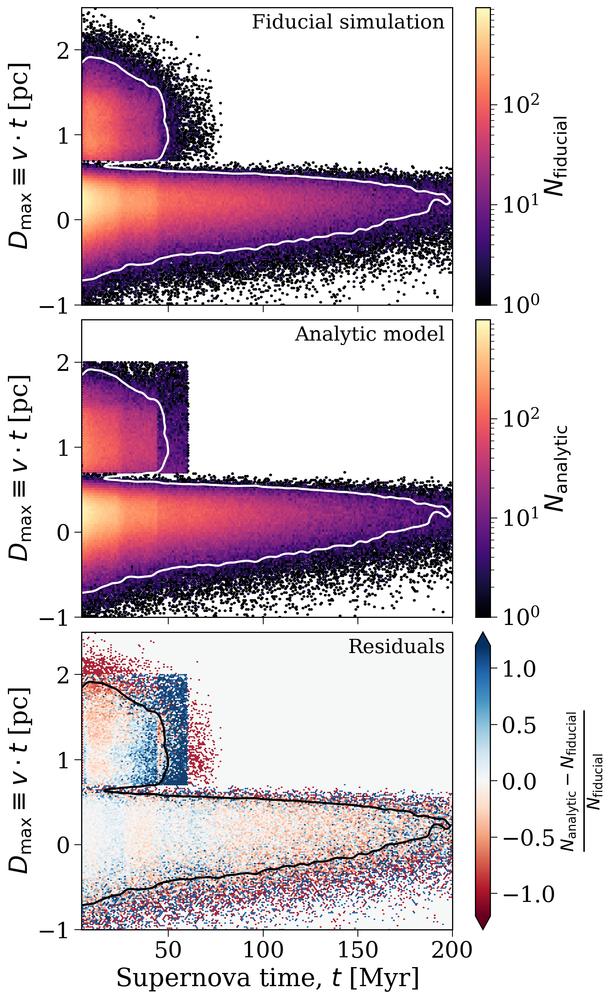

In [353]:
extent = (4, 200, -1, 2.5)
gridsize = 200

fig, axes = plt.subplots(3, 1, figsize=(8, 16), sharex=True)

fig.subplots_adjust(hspace=0.05)

dists = (vels * times * u.km / u.s * u.Myr).to(u.pc).value

hb1 = axes[1].hexbin(times, np.log10(vels), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)
fig.colorbar(hb1, label=r"$N_{\rm analytic}$", ax=axes[1])# plt.show()

p = "fiducial"
t_list = plotting.get_data_and_weights(pops[p], "time", [1])[0]
t = np.concatenate(t_list)

hb2 = axes[0].hexbin(t, np.log10(v), extent=extent, gridsize=gridsize, bins="log", cmap="magma", rasterized=True)
fig.colorbar(hb2, label=r"$N_{\rm fiducial}$", ax=axes[0])


# Compute difference
counts1 = hb1.get_array()
counts2 = hb2.get_array()
diff_counts = ((counts1 - counts2) / counts2).data # Compute difference

bin_centers = hb1.get_offsets()
x_centers, y_centers = bin_centers[:, 0], bin_centers[:, 1]

# Create a grid of x and y values
xi = np.linspace(x_centers.min(), x_centers.max(), 220)
yi = np.linspace(y_centers.min(), y_centers.max(), 220)
xi, yi = np.meshgrid(xi, yi)

# Interpolate the z values onto the grid
zi = griddata((x_centers, y_centers), counts2, (xi, yi), method='linear')

sorted_counts = np.sort(counts2)[::-1]  # Sort descending
cumsum_counts = np.cumsum(sorted_counts)  # Cumulative sum
cumsum_counts /= cumsum_counts[-1]  # Normalize to fraction of total

# Find the value corresponding to the 98% threshold
contour_level = sorted_counts[np.searchsorted(cumsum_counts, 0.98)]

# New plot with differences
hb_diff = axes[2].hexbin(x_centers, y_centers, gridsize=gridsize, C=diff_counts, alpha=None, extent=extent,
                         cmap="RdBu", edgecolor="none", vmin=-1.2, vmax=1.2, rasterized=True)
fig.colorbar(hb_diff, label=r"$\frac{N_{\rm analytic} - N_{\rm fiducial}}{N_{\rm fiducial}}$", ax=axes[2], extend="both")

for ax, label in zip(axes, ["Fiducial simulation", "Analytic model", "Residuals"]):
    ax.set(xlim=(extent[0], extent[1]),
           ylim=(extent[2], extent[3]),
           ylabel=r"$D_{\rm max} \equiv v \cdot t$ [pc]")
    # ax.set_yticks([0, 1, 2, 3, 4])
    # ax.set_yticklabels([r"$10^{0}$", r"$10^{1}$", r"$10^{2}$", r"$10^{3}$", r"$10^{4}$"])
    ax.annotate(label, xy=(0.98, 0.98), xycoords="axes fraction", ha="right", va="top", fontsize=0.8*fs)
    ax.contour(xi, yi, ndimage.gaussian_filter(zi, sigma=2), levels=[contour_level],
               colors="white" if label != "Residuals" else "black", linewidths=2)
axes[-1].set(xlabel="Supernova time, $t$ [Myr]")

# plt.savefig("../plots/fit-2d.pdf", format="pdf", bbox_inches="tight")

plt.show()

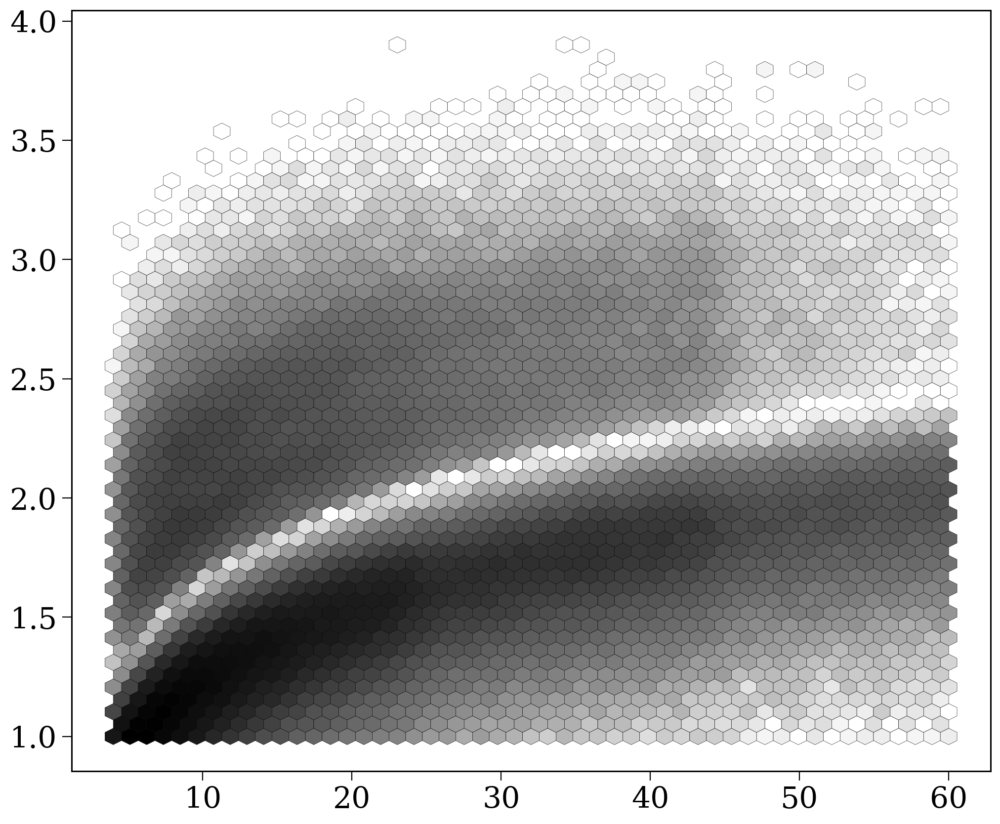

Done, now for pie


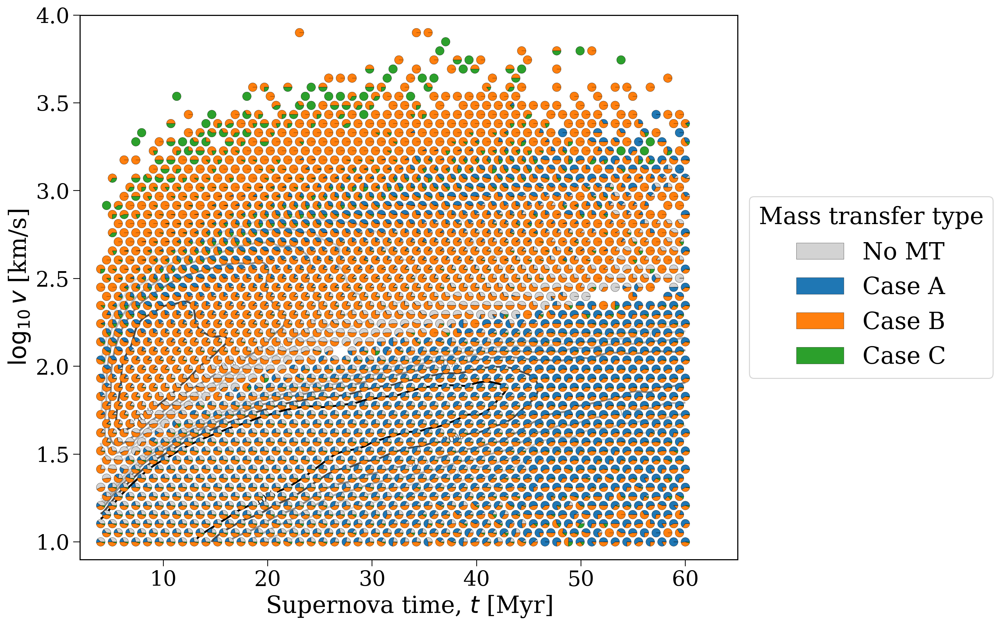

CPU times: user 1min 1s, sys: 1.55 s, total: 1min 3s
Wall time: 1min 2s


In [1116]:
%%time
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
from scipy.spatial import cKDTree

p = "fiducial"
t_list = plotting.get_data_and_weights(pops[p], "time", [1])[0]
t = np.concatenate(t_list)

extent=(4, 60, 1.0, 3.9)

# hb2 = axes[0].hexbin(t, np.log10(v * t), C=sn_mt1_type, extent=extent, gridsize=gridsize, rasterized=True, reduce_C_function=np.median)
# fig.colorbar(hb2, label=r"$N_{\rm fiducial}$", ax=axes[0])

# Create hexbin plot
gridsize = 50
fig, ax = plt.subplots(figsize=(12, 10))
x = t
y = np.log10(v * t)
categories = sn_mt1_type.astype(int)
hb = ax.hexbin(x, y, gridsize=gridsize, extent=extent, cmap="Greys", mincnt=1, edgecolors='k', linewidths=0.2, bins="log")

plt.show()
fig, ax = plt.subplots(figsize=(12, 10))

bin_centers = hb.get_offsets()
x_centers, y_centers = bin_centers[:, 0], bin_centers[:, 1]

# Create a grid of x and y values
xi = np.linspace(x_centers.min(), x_centers.max(), 220)
yi = np.linspace(y_centers.min(), y_centers.max(), 220)
xi, yi = np.meshgrid(xi, yi)

# Interpolate the z values onto the grid
zi = griddata((x_centers, y_centers), hb.get_array().data, (xi, yi), method='linear')

sorted_counts = np.sort(counts2)[::-1]  # Sort descending
cumsum_counts = np.cumsum(sorted_counts)  # Cumulative sum
cumsum_counts /= cumsum_counts[-1]  # Normalize to fraction of total

# Find the value corresponding to the 98% threshold
contour_levels = list(reversed([sorted_counts[np.searchsorted(cumsum_counts, t)] for t in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]]))

CS = ax.contour(xi, yi, ndimage.gaussian_filter(zi, sigma=2), levels=contour_levels,
           cmap="binary", linewidths=2, )
ax.clabel(CS, contour_levels, fmt={contour_levels[i]: f"{(len(contour_levels) - i) * 10:1.0f}%" for i in range(len(contour_levels))})

# Get true hexagon centers from hexbin
hex_centers = hb.get_offsets()
num_hexes = len(hex_centers)

# **FAST NEAREST NEIGHBOR MATCHING USING KD-TREE**
# Build KD-Tree from hexbin centers
tree = cKDTree(hex_centers)

# Find nearest hexbin center for each (x, y) point
_, nearest_hex_indices = tree.query(np.column_stack((x, y)), workers=-1)  # Multi-threaded

# **FAST CATEGORY COUNTING PER HEXBIN**
# Create an array to store category counts for each hexbin
hex_category_counts = np.zeros((num_hexes, 4), dtype=int)

# Vectorized accumulation of counts per hexbin & category
np.add.at(hex_category_counts, (nearest_hex_indices, categories), 1)

print("Done, now for pie")

# ax.set_aspect("equal")

# **Keep original axis scaling**
ax.set_xlim(extent[0] - 2, extent[1] + 5)
ax.set_ylim(extent[2] - 0.1, extent[3] + 0.1)

# **Transform hexbin centers to figure coordinates**
transform = ax.transLimits.transform
for i, cat_counts in enumerate(hex_category_counts):
    # ax.set_xlim(4, 200)
    # ax.set_ylim(-0.1, 4.2)
    total = cat_counts.sum()
    if total > 0:
        fractions = cat_counts / total
        hex_x, hex_y = hex_centers[i]
        
        # Convert (hex_x, hex_y) from data coordinates to figure coordinates
        fig_x, fig_y = transform((hex_x, hex_y))
        # fig_x, fig_y = fig.transFigure.inverted().transform((fig_x, fig_y))
        # print(hex_x, hex_y, fig_x, fig_y)

        # fig_x = ax.get_xaxis_transform().transform(hex_x)
        # fig_y = ax.get_yaxis_transform().transform(hex_y)
        # print(hex_x, hex_y, fig_x, fig_y)

        # Create a small inset axis for the pie chart
        pie_size = 0.02  # Adjust pie size (relative to figure size)
        ax_pie = ax.inset_axes([fig_x - pie_size / 2, fig_y - pie_size / 2, pie_size, pie_size])
        wedges, texts = ax_pie.pie(fractions, colors=["lightgrey", "tab:blue", "tab:orange", "tab:green"],
                                              wedgeprops={'edgecolor': 'k', 'linewidth': 0.2}, frame=False)
        ax_pie.set_xticks([])
        ax_pie.set_yticks([])
        ax_pie.set_frame_on(False)
        # break

leg = ax.legend(wedges, ["No MT", "Case A", "Case B", "Case C"],
                title = "Mass transfer type",
                loc="center left",
                bbox_to_anchor=(1, 0, 0.5, 1), title_fontsize=fs)


# **Keep original axis scaling**
# ax.set_xlim(extent[0] - 5, extent[1] + 5)
# ax.set_ylim(extent[2] - 0.1, extent[3] + 0.1)

ax.set(xlabel="Supernova time, $t$ [Myr]",
       ylabel=r"$\log_{10} v $ [km/s]")
plt.show()

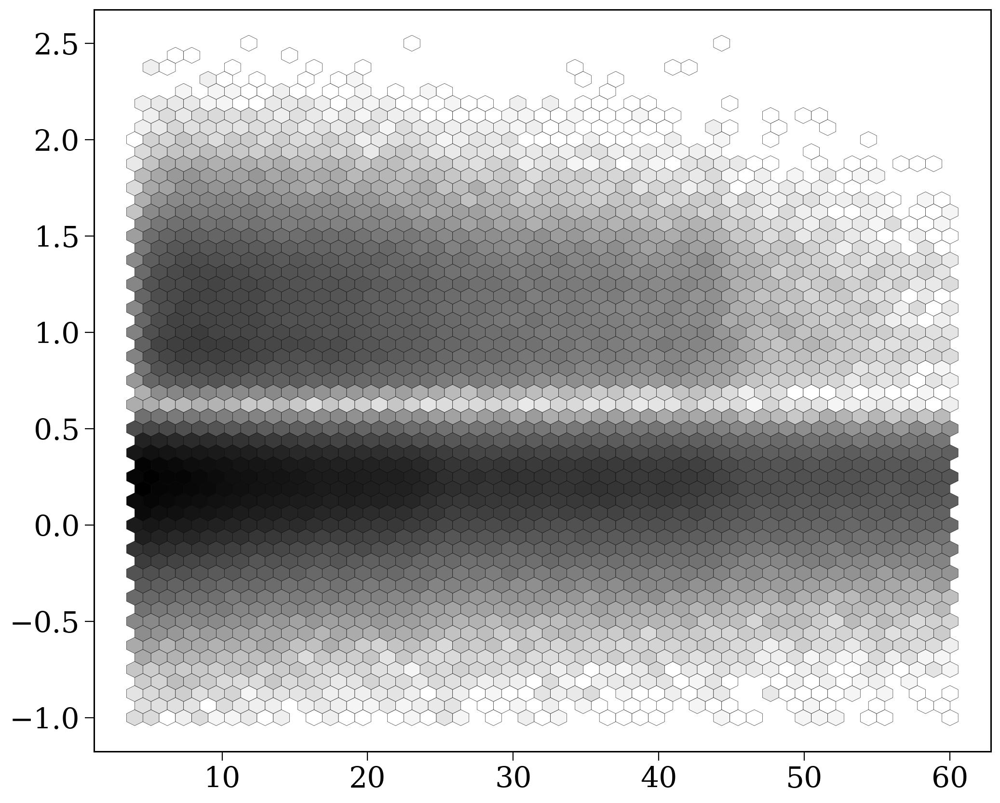

Done, now for pie


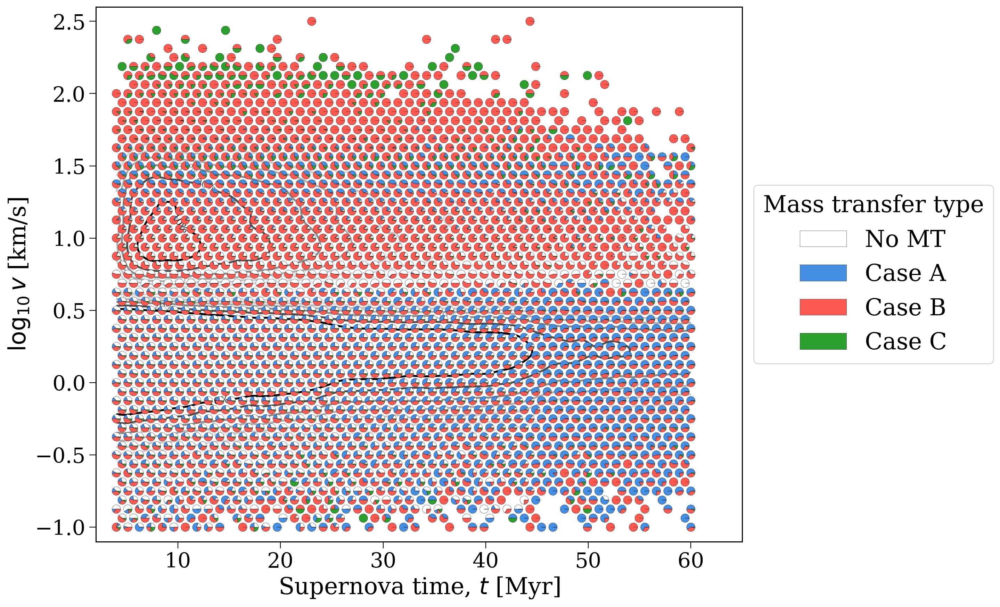

CPU times: user 1min 2s, sys: 1.29 s, total: 1min 4s
Wall time: 1min 3s


In [1159]:
%%time
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
from scipy.spatial import cKDTree

p = "fiducial"
t_list = plotting.get_data_and_weights(pops[p], "time", [1])[0]
t = np.concatenate(t_list)

extent=(4, 60, -1, 2.5)

# hb2 = axes[0].hexbin(t, np.log10(v * t), C=sn_mt1_type, extent=extent, gridsize=gridsize, rasterized=True, reduce_C_function=np.median)
# fig.colorbar(hb2, label=r"$N_{\rm fiducial}$", ax=axes[0])

# Create hexbin plot
gridsize = 50
fig, ax = plt.subplots(figsize=(12, 10))
x = t
y = np.log10(v)
categories = sn_mt1_type.astype(int)
hb = ax.hexbin(x, y, gridsize=gridsize, extent=extent, cmap="Greys", mincnt=1, edgecolors='k', linewidths=0.2, bins="log")

plt.show()
fig, ax = plt.subplots(figsize=(12, 10))

bin_centers = hb.get_offsets()
x_centers, y_centers = bin_centers[:, 0], bin_centers[:, 1]

# Create a grid of x and y values
xi = np.linspace(x_centers.min(), x_centers.max(), 220)
yi = np.linspace(y_centers.min(), y_centers.max(), 220)
xi, yi = np.meshgrid(xi, yi)

# Interpolate the z values onto the grid
zi = griddata((x_centers, y_centers), hb.get_array().data, (xi, yi), method='linear')

sorted_counts = np.sort(counts2)[::-1]  # Sort descending
cumsum_counts = np.cumsum(sorted_counts)  # Cumulative sum
cumsum_counts /= cumsum_counts[-1]  # Normalize to fraction of total

# Find the value corresponding to the 98% threshold
contour_levels = list(reversed([sorted_counts[np.searchsorted(cumsum_counts, t)] for t in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]]))

CS = ax.contour(xi, yi, ndimage.gaussian_filter(zi, sigma=2), levels=contour_levels,
           cmap="binary", linewidths=2, )
ax.clabel(CS, contour_levels, fmt={contour_levels[i]: f"{(len(contour_levels) - i) * 10:1.0f}%" for i in range(len(contour_levels))})

# Get true hexagon centers from hexbin
hex_centers = hb.get_offsets()
num_hexes = len(hex_centers)

# **FAST NEAREST NEIGHBOR MATCHING USING KD-TREE**
# Build KD-Tree from hexbin centers
tree = cKDTree(hex_centers)

# Find nearest hexbin center for each (x, y) point
_, nearest_hex_indices = tree.query(np.column_stack((x, y)), workers=-1)  # Multi-threaded

# **FAST CATEGORY COUNTING PER HEXBIN**
# Create an array to store category counts for each hexbin
hex_category_counts = np.zeros((num_hexes, 4), dtype=int)

# Vectorized accumulation of counts per hexbin & category
np.add.at(hex_category_counts, (nearest_hex_indices, categories), 1)

print("Done, now for pie")

# ax.set_aspect("equal")

# **Keep original axis scaling**
ax.set_xlim(extent[0] - 2, extent[1] + 5)
ax.set_ylim(extent[2] - 0.1, extent[3] + 0.1)

# **Transform hexbin centers to figure coordinates**
transform = ax.transLimits.transform
for i, cat_counts in enumerate(hex_category_counts):
    # ax.set_xlim(4, 200)
    # ax.set_ylim(-0.1, 4.2)
    total = cat_counts.sum()
    if total > 0:
        fractions = cat_counts / total
        hex_x, hex_y = hex_centers[i]
        
        # Convert (hex_x, hex_y) from data coordinates to figure coordinates
        fig_x, fig_y = transform((hex_x, hex_y))
        # fig_x, fig_y = fig.transFigure.inverted().transform((fig_x, fig_y))
        # print(hex_x, hex_y, fig_x, fig_y)

        # fig_x = ax.get_xaxis_transform().transform(hex_x)
        # fig_y = ax.get_yaxis_transform().transform(hex_y)
        # print(hex_x, hex_y, fig_x, fig_y)

        # Create a small inset axis for the pie chart
        pie_size = 0.02  # Adjust pie size (relative to figure size)
        ax_pie = ax.inset_axes([fig_x - pie_size / 2, fig_y - pie_size / 2, pie_size, pie_size])
        wedges, texts = ax_pie.pie(fractions, colors=["white", "xkcd:dark sky blue", "xkcd:coral", "tab:green"],
                                              wedgeprops={'edgecolor': 'k', 'linewidth': 0.2}, frame=False)
        ax_pie.set_xticks([])
        ax_pie.set_yticks([])
        ax_pie.set_frame_on(False)
        # break

leg = ax.legend(wedges, ["No MT", "Case A", "Case B", "Case C"],
                title = "Mass transfer type",
                loc="center left",
                bbox_to_anchor=(1, 0, 0.5, 1), title_fontsize=fs)


# **Keep original axis scaling**
# ax.set_xlim(extent[0] - 5, extent[1] + 5)
# ax.set_ylim(extent[2] - 0.1, extent[3] + 0.1)

ax.set(xlabel="Supernova time, $t$ [Myr]",
       ylabel=r"$\log_{10} v $ [km/s]")
plt.show()

# Previous attempts
## Distances

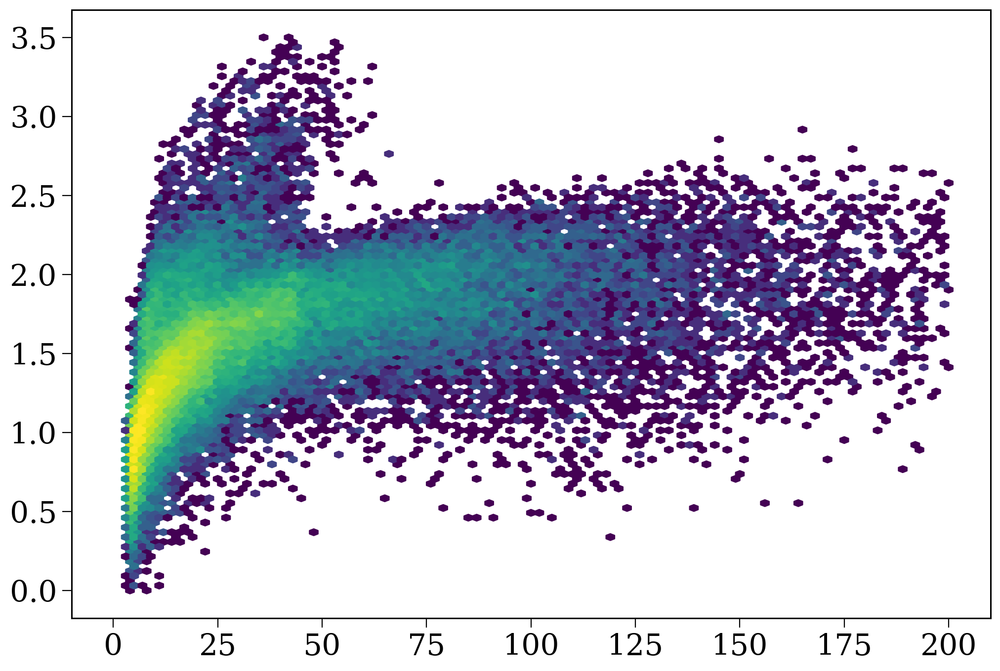

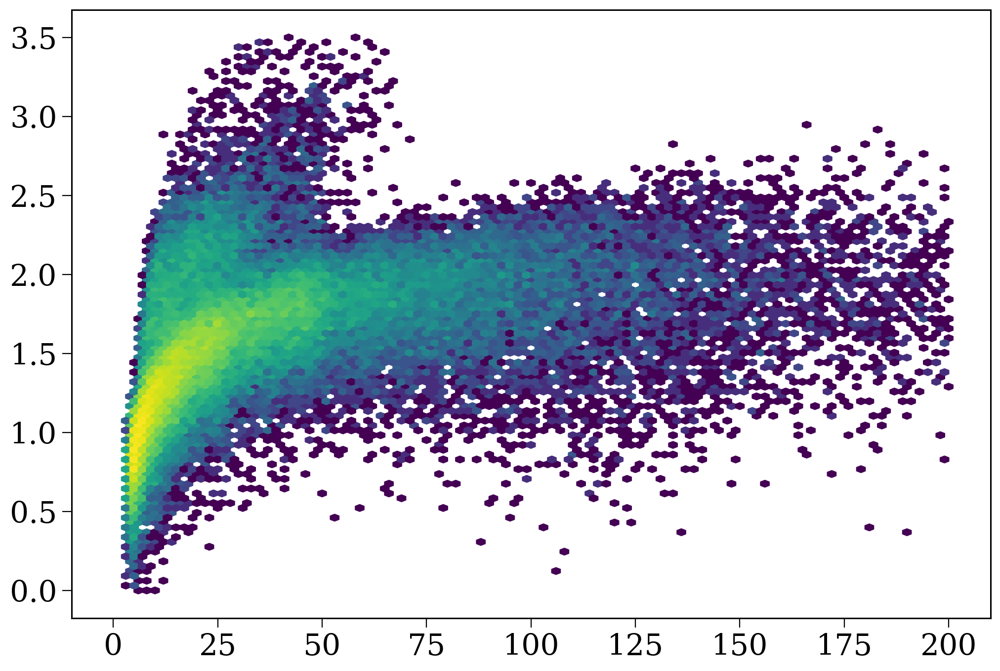

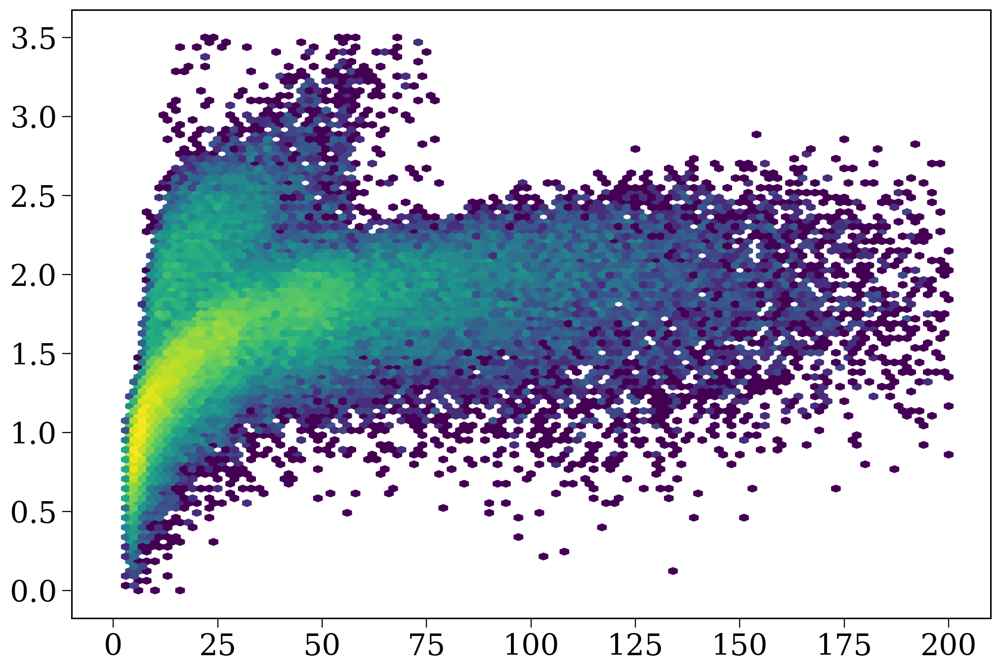

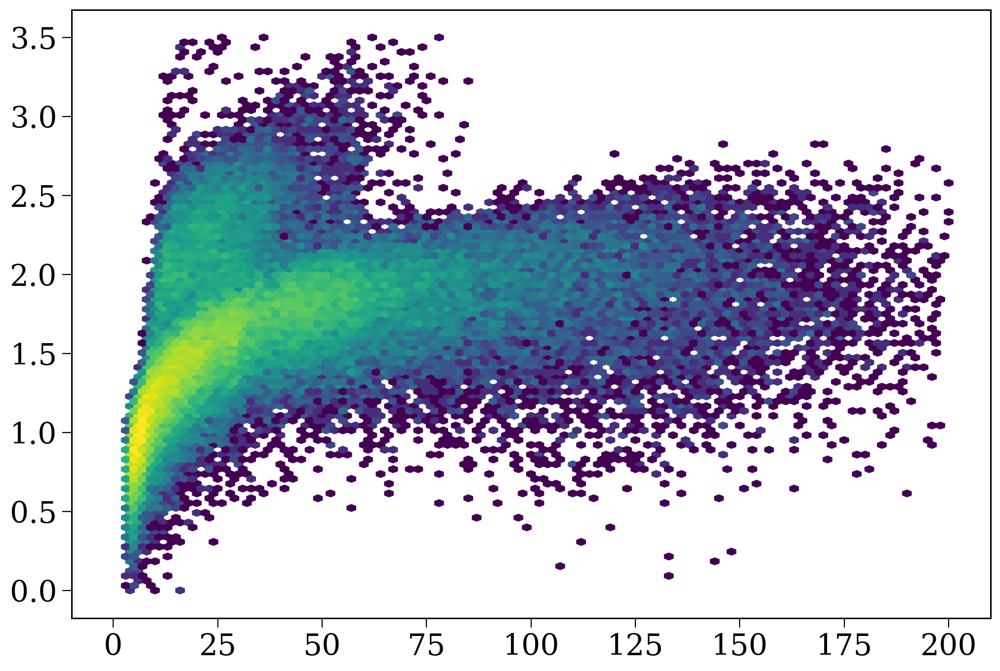

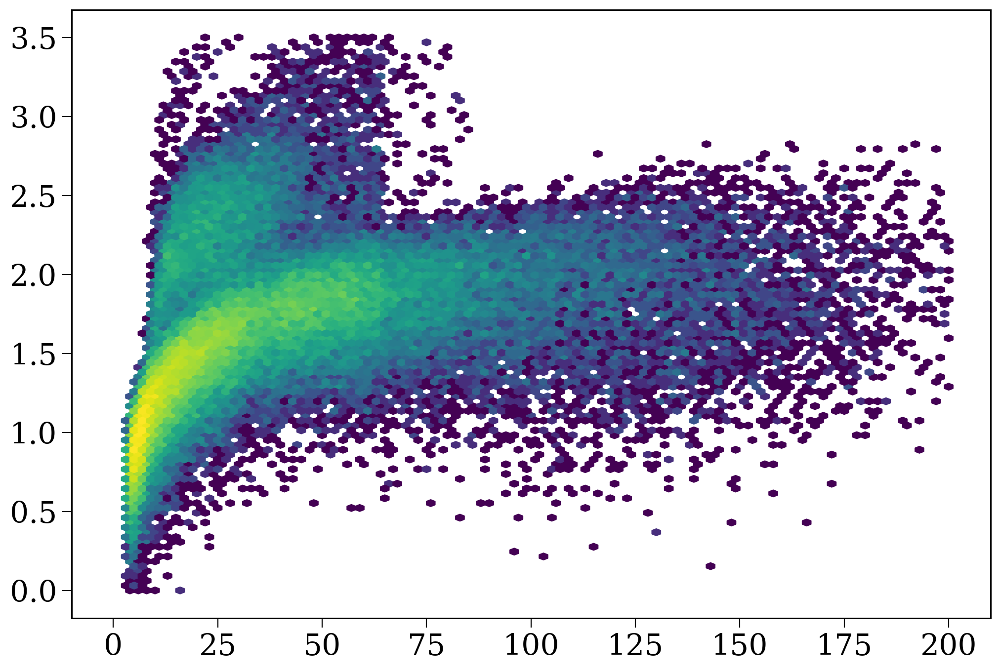

In [123]:
for p in pops:
    d = np.concatenate(([plotting.get_data_and_weights(pops[p], "distance", [1])[0][i] for i in [0, 1, 2, 3]]))
    t = np.concatenate(([plotting.get_data_and_weights(pops[p], "time", [1])[0][i] for i in [0, 1, 2, 3]]))

    plt.hexbin(t, np.log10(d), extent=(0, 200, 0, 3.5), vmax=200, bins="log")
    plt.show()

In [178]:
def plot_d_given_t(tmin, tmax, **kwargs):
    plt.hist(np.log10(d[(t >= tmin) & (t < tmax)]), bins=50, range=(0, 3), histtype="step", lw=2, label=f"({tmin}, {tmax})", density=True, **kwargs)

In [152]:
from scipy.stats import norm, lognorm

In [128]:
def get_d_t(p, which=[0, 1, 2, 3]):
    d = np.concatenate(([plotting.get_data_and_weights(pops[p], "distance", [1])[0][i] for i in which]))
    t = np.concatenate(([plotting.get_data_and_weights(pops[p], "time", [1])[0][i] for i in which]))
    return d, t

In [204]:
d, t = get_d_t("Z-0.05", [1])

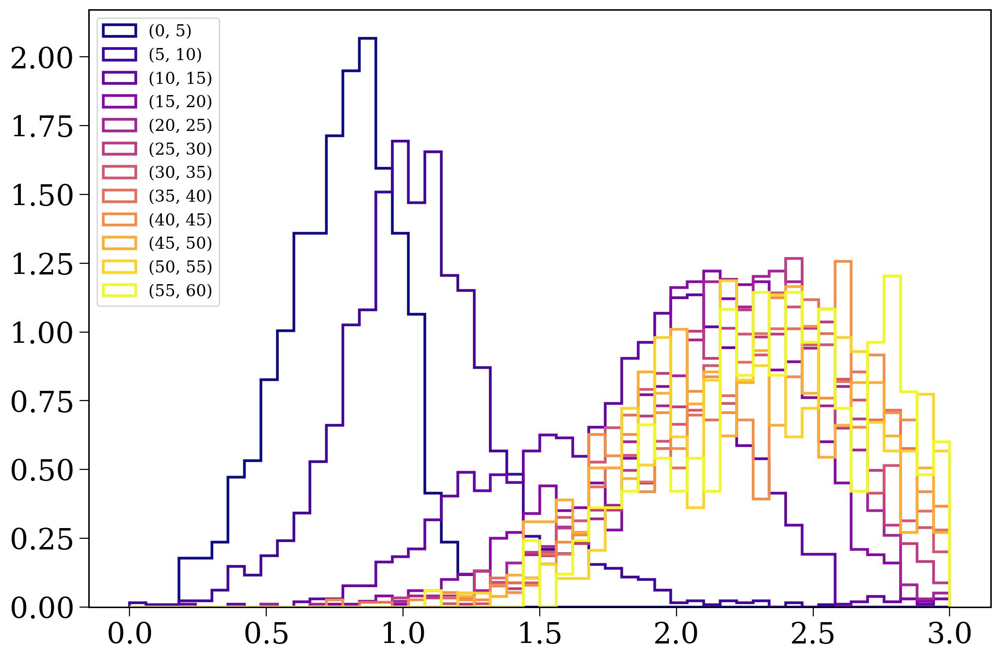

In [207]:
chunks = [(3, 5), (5, 10), (10, 15), (15, 20), (20, 25), (25, 30), (30, 40), (40, 50), (50, 80), (80, 120), (120, 200)]
# chunks = [(0, 10), (10, 20), (20, 30), (30, 50), (50, 80), (80, 120), (120, 200)]
chunks = [(x, x + 5) for x in range(0, 60, 5)]
for i, chunk in enumerate(chunks):
    left, right = chunk
    plot_d_given_t(left, right, color=plt.get_cmap("plasma", len(chunks))(i))
    # print((d[(t >= left) & (t < right)] > 100)

x = np.linspace(0, 3, 5000)
# plt.plot(x, lognorm(s=2, loc=20, scale=5).pdf(x))
# plt.plot(x, norm(loc=1.55, scale=0.25).pdf(x))# + norm(loc=2.1, scale=0.5).pdf(x) * 0.2)
# for i, chunk in enumerate(chunks):
#     plt.plot(x, norm(loc=1.0 + 0.4 * np.sqrt(i), scale=0.24 - 0.02 * i).pdf(x), color=plt.get_cmap("plasma", len(chunks))(i), linestyle='dotted')

plt.legend(fontsize=0.5*fs)
# plt.xscale("log")
# plt.yscale("log")

plt.show()

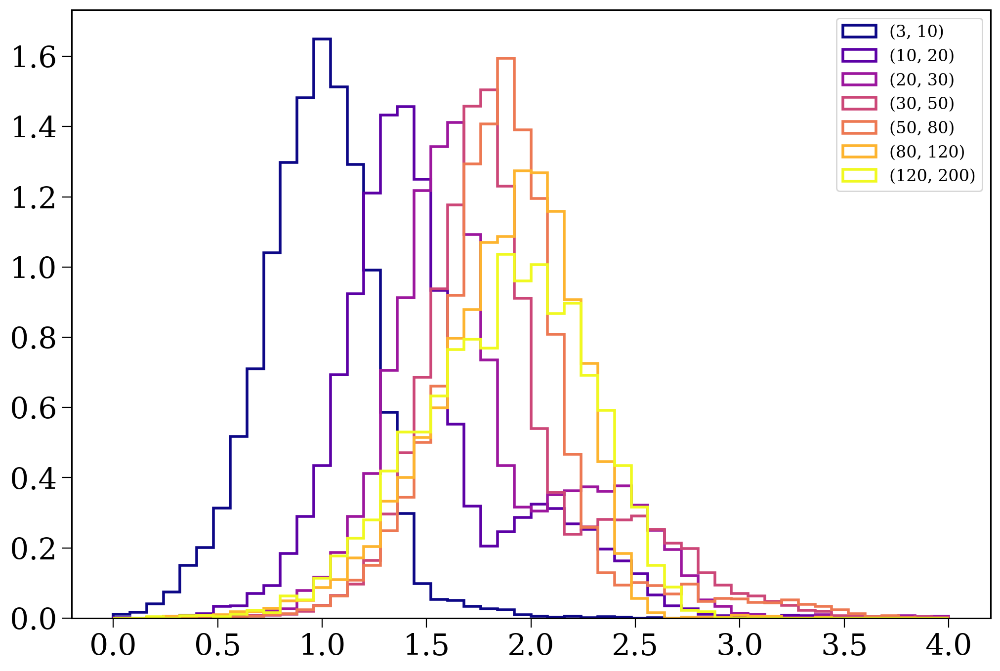

In [124]:
chunks = [(3, 5), (5, 10), (10, 15), (15, 20), (20, 25), (25, 30), (30, 40), (40, 50), (50, 80), (80, 120), (120, 200)]
chunks = [(3, 10), (10, 20), (20, 30), (30, 50), (50, 80), (80, 120), (120, 200)]
for i, chunk in enumerate(chunks):
    left, right = chunk
    plot_d_given_t(left, right, color=plt.get_cmap("plasma", len(chunks))(i))

x = np.linspace(0, 4, 1000)
# plt.plot(x, norm(loc=1.45, scale=0.25).pdf(x))
# plt.plot(x, norm(loc=1.55, scale=0.25).pdf(x) + norm(loc=2.1, scale=0.5).pdf(x) * 0.2)
# plt.plot(x, norm(loc=1.9, scale=0.4).pdf(x))

plt.legend(fontsize=0.5*fs)
# plt.xscale("log")
# plt.yscale("log")

plt.show()

[ 2.59058836e+05  1.22510539e+00  2.05640543e+00  1.03124469e+02
  1.33887115e+05  4.61434566e-01 -2.64238768e+01  1.02215049e+02
  3.30458668e+03  2.83178253e-01  2.23410346e+01  2.85523743e+01]


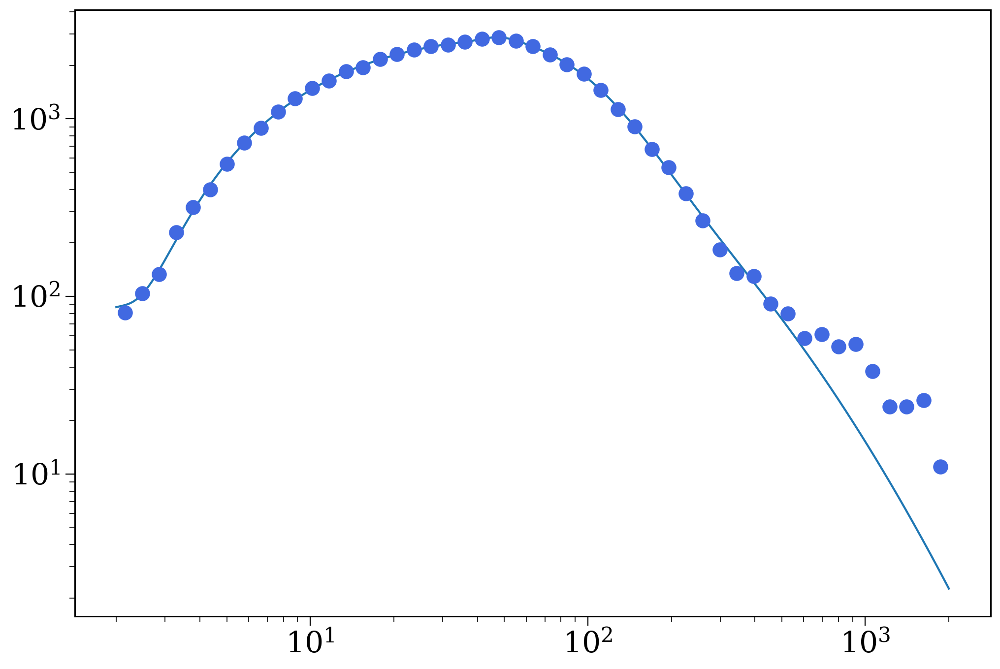

In [25]:
bins = np.geomspace(2e0, 2e3, 50)
bin_centres, widths = plotting.get_centres_widths(bins)

# i = 0
for p in ["fiducial"]:#pops:
    if p in ["singles", "alpha-vir-0.1", "alpha-vir-10.0"]:
        continue
    # i += 1
    # if i < 10:
    #     continue
    dists, weights = plotting.get_data_and_weights(pops[p], var="distance", widths=widths)
    d, w = np.concatenate(dists), np.concatenate(weights)
    if p == "r442":
        w *= 0.1
    plt.scatter(bin_centres, np.histogram(d, bins=bins, weights=w)[0], label=p,
             lw=5 if p == "fiducial" else 2,
             alpha=1 if p == "fiducial" else 0.4,
             color="royalblue" if p == "fiducial" else "grey",
             zorder=1000 if p == "fiducial" else None)
plt.xscale("log")

def dist_dist(d, a, s, l, sc, b, s2, l2, sc2, c, s3, l3, sc3):
    return a * lognorm(s=s, loc=l, scale=sc).pdf(d) + b * lognorm(s=s2, loc=l2, scale=sc2).pdf(d) + c * lognorm(s=s3, loc=l3, scale=sc3).pdf(d)

p0 = [1e3, 1, 0, 80, 1000, 0.5, 1, 100, 1000, 0.5, 1, 100]
d_range = np.geomspace(min(bins), max(bins), 1000)
# plt.plot(d_range, dist_dist(d_range, *p0))
plt.yscale("log")

popt, pcov = curve_fit(dist_dist, bin_centres, np.histogram(d, bins=bins, weights=w)[0], p0=p0)
print(popt)
plt.plot(d_range, dist_dist(d_range, *popt))

# plt.legend()
plt.show()

[5.01035531e+04 3.22406218e+00 7.30415707e-01 1.51011514e+05
 6.35273775e+00 1.55338346e+00 2.50097786e+05 4.42963231e+00
 6.72266415e-01]


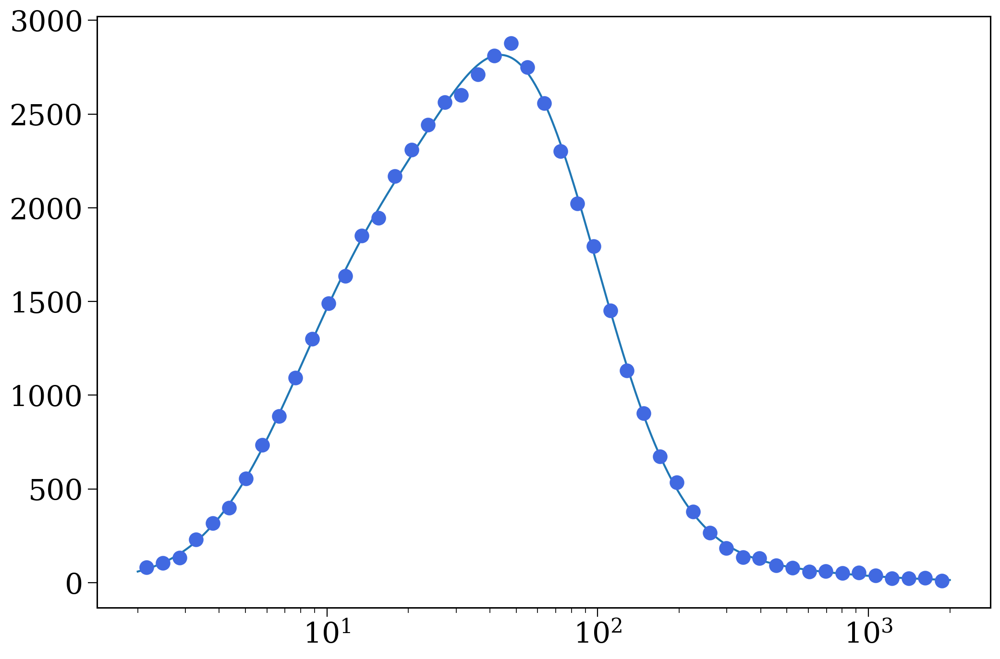

In [73]:
bins = np.geomspace(2e0, 2e3, 50)
bin_centres, widths = plotting.get_centres_widths(bins)

# i = 0
for p in ["fiducial"]:#pops:
    if p in ["singles", "alpha-vir-0.1", "alpha-vir-10.0"]:
        continue
    # i += 1
    # if i < 10:
    #     continue
    times, _ = plotting.get_data_and_weights(pops[p], var="time", widths=widths)
    dists, weights = plotting.get_data_and_weights(pops[p], var="distance", widths=widths)
    d, w, t = np.concatenate(dists), np.concatenate(weights), np.concatenate(times)

    mask = (t > 0) & (t < 500)
    d, w, t = d[mask], w[mask], t[mask]
    
    if p == "r442":
        w *= 0.1
    plt.scatter(bin_centres, np.histogram(d, bins=bins, weights=w)[0], label=p,
             lw=5 if p == "fiducial" else 2,
             alpha=1 if p == "fiducial" else 0.4,
             color="royalblue" if p == "fiducial" else "grey",
             zorder=1000 if p == "fiducial" else None)
plt.xscale("log")

def dist_dist(d, a, a_mu, a_sigma, b, b_mu, b_sigma, c, c_mu, c_sigma):
    # if a <= 0 or b <= 0 or c <= 0 or a_mu <= 0 or b_mu <= 0 or c_mu <= 0 or a_sigma <= 0 or b_sigma <= 0 or c_sigma <= 0:
    #     return -np.ones_like(d)
    return a * lognorm(s=a_sigma, scale=np.exp(a_mu)).pdf(d) + b * lognorm(s=b_sigma, scale=np.exp(b_mu)).pdf(d) + c * lognorm(s=c_sigma, scale=np.exp(c_mu)).pdf(d)

p0 = [1e3, 1, 1, 1e3, 0.5, 1, 1e3, 0.5, 1]
p0 = [5.01037068e+04, 3.22406440e+00, 7.30416183e-01, 1.51010887e+05, 6.35271142e+00,
      1.55337616e+00, 2.50096957e+05, 4.42963198e+00, 6.72265648e-01]
d_range = np.geomspace(min(bins), max(bins), 1000)
# plt.plot(d_range, dist_dist(d_range, *p0))
# plt.yscale("log")

popt, pcov = curve_fit(dist_dist, bin_centres, np.histogram(d, bins=bins, weights=w)[0], p0=p0, bounds=([0 for p in p0], [np.inf for p in p0]))
print(popt)
plt.plot(d_range, dist_dist(d_range, *popt))

# plt.legend()
plt.show()

# Stuff for David

In [800]:
from cosmic.sample.initialbinarytable import InitialBinaryTable
from cosmic.evolve import Evolve
import matplotlib.pyplot as plt
import numpy as np
import astropy.units as u
import seaborn as sns

single_binary = InitialBinaryTable.InitialBinaries(m1=20, m2=15, porb=100, ecc=0.0, tphysf=13700.0,
                                                   kstar1=1, kstar2=1, metallicity=0.02)

N = 50000
ibt = single_binary.loc[single_binary.index.repeat(N)].reset_index()
BSEDict = {'xi': 1.0, 'bhflag': 1, 'neta': 0.5, 'windflag': 3, 'wdflag': 1, 'alpha1': 1.0, 'pts1': 0.001, 'pts3': 0.02, 'pts2': 0.01, 'epsnov': 0.001, 'hewind': 0.5, 'ck': 1000, 'bwind': 0.0, 'lambdaf': 0.0, 'mxns': 3.0, 'beta': -1.0, 'tflag': 1, 'acc2': 1.5, 'grflag': 1, 'remnantflag': 4, 'ceflag': 0, 'eddfac': 1.0, 'ifflag': 0, 'bconst': 3000, 'sigma': 265, 'gamma': -2.0, 'pisn': 45.0, 'natal_kick_array': [[-100.0, -100.0, -100.0, -100.0, 0.0], [-100.0, -100.0, -100.0, -100.0, 0.0]], 'bhsigmafrac': 1.0, 'polar_kick_angle': 90, 'qcrit_array': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], 'cekickflag': 2, 'cehestarflag': 0, 'cemergeflag': 0, 'ecsn': 2.25, 'ecsn_mlow': 1.6, 'aic': 1, 'ussn': 0, 'sigmadiv': -20.0, 'qcflag': 5, 'eddlimflag': 0, 'fprimc_array': [0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523, 0.09523809523809523], 'bhspinflag': 0, 'bhspinmag': 0.0, 'rejuv_fac': 1.0, 'rejuvflag': 0, 'htpmb': 1, 'ST_cr': 1, 'ST_tide': 1, 'bdecayfac': 1, 'rembar_massloss': 0.5, 'kickflag': 1, 'zsun': 0.014, 'bhms_coll_flag': 0, 'don_lim': -1, 'acc_lim': -1, 'binfrac': 0.5, 'rtmsflag': 0, 'wd_mass_lim': 1}

In [801]:
%%time
bpp, bcm, ibt, kick_info = Evolve.evolve(initialbinarytable=ibt, BSEDict=BSEDict, nproc=2)

/mnt/home/twagg/miniconda3/envs/cogsworth/lib/python3.10/site-packages/cosmic/evolve.py:286: UserWarning: The value for binfrac in initial binary table is being overwritten by the value of binfrac from either the params file or the BSEDict.
  warnings.warn("The value for {0} in initial binary table is being "


CPU times: user 3.16 s, sys: 1.2 s, total: 4.36 s
Wall time: 13min 36s


In [803]:
bpp.to_hdf("cosmic_kick_data.h5", key="bpp")

In [804]:
kick_info.to_hdf("cosmic_kick_data.h5", key="kick_info")

In [46]:
times = plotting.get_data_and_weights(pops["fiducial"], "time", [1])[0]

In [48]:
[len(t) for t in times]

[378076, 182812, 283504, 16426]

In [50]:
np.median(np.concatenate([times[0], times[2], times[3]]))

25.11826733065024

In [51]:
np.median(times[1])

15.297687520185832